# Front Finding Algorithm

In [1]:
#### Enable autoreload extension to automatically reload modules
%load_ext autoreload
%autoreload 1

# Import necessary modules and libraries
import AirSeaFluxCode  # Import AirSeaFluxCode class from AirSeaFluxCode module
import xarray as xr  # Import xarray library with alias xr
import gsw_xarray as gsw  # Import gsw_xarray module with alias gsw
import matplotlib.dates as mdates  # Import module for working with dates in matplotlib
import matplotlib.pyplot as plt  # Import matplotlib.pyplot for plotting
import numpy as np  # Import numpy library with alias np for numerical operations
import cartopy.crs as ccrs  # Import cartopy for geospatial data visualization
import cmocean.cm as cmo  # Import colormaps from cmocean for oceanography
from matplotlib.lines import Line2D
import statsmodels.api as sm
from matplotlib.ticker import FuncFormatter
from collections import defaultdict
from tqdm.notebook import tqdm_notebook as tqdm
import scipy.stats as sstats
import pandas as pd
from joblib import Parallel, delayed
import matplotlib.patches as patches
from matplotlib.ticker import MaxNLocator
from matplotlib.colors import LogNorm
from matplotlib.patches import ConnectionPatch
import seaborn as sns
from collections import Counter
import numpy as np
# Import my_funcs module for interactive reloading
%aimport my_funcs

# Call update_params function from my_funcs module to update parameters
my_funcs.update_params(fontsize=30)
# Specify the custom font family
#font = {'size': 24}
# font = {'family': 'Verdana Bold'}


# Define color variables with hexadecimal color codes
c20 = "#C13F89"  # Define color c20
c22 = "#00B4D8"  # Define color c22
c23 = "#0077B6"  # Define color c23

# Manually create Line2D objects for legend handles
legend_lines = [
    Line2D([], [], color=c20, lw=3, label='SD1020'),
    Line2D([], [], color=c22, lw=3, label='SD1022'),
    Line2D([], [], color=c23, lw=3, label='SD1023')]

# Manually create Line2D objects for legend handles
legend_dots = [
    Line2D([], [], color=c20, lw=0, marker='.', ms=25, label='SD1020'),
    Line2D([], [], color=c22, lw=0, marker='.', ms=25, label='SD1022'),
    Line2D([], [], color=c23, lw=0, marker='.', ms=25, label='SD1023')]


#f'{x*100:.0f}%'
colors = [c20, c22, c23]
labels = ["SD1020", "SD1022", "SD1023"]

In [2]:
def white_or_black(color):
    
    c1 = "white" if color == "white" else "black"
    c2 = "black" if color == "white" else "white"
    
    plt.rcParams.update({
        'figure.facecolor': c1,  # Background color of the figure
        'axes.facecolor': c1,    # Background color inside the plot area
        'savefig.facecolor': c1, # Background color when saving the figure
        'axes.edgecolor': c2,    # Color of the axes border
        'axes.labelcolor': c2,   # Color of the axis labels
        'xtick.color': c2,       # Color of the x-tick labels
        'ytick.color': c2,       # Color of the y-tick labels
        'text.color': c2,        # Default text color
        'axes.titlecolor': c2,   # Color of the plot title
        'font.size': 30,              # Size of the font
    })

In [3]:
ds20 = xr.open_dataset("../data/ds20qc_1min_200m.nc")
ds22 = xr.open_dataset("../data/ds22qc_1min_200m.nc")
ds23 = xr.open_dataset("../data/ds23qc_1min_200m.nc")

In [234]:
ds22

<xarray.Dataset> Size: 28MB
Dimensions:                        (distance: 65318)
Coordinates:
  * distance                       (distance) float64 523kB 0.0 ... 1.306e+04
Data variables: (12/52)
    latitude                       (distance) float64 523kB ...
    longitude                      (distance) float64 523kB ...
    SOG                            (distance) float64 523kB ...
    COG                            (distance) float64 523kB ...
    HDG                            (distance) float64 523kB ...
    HDG_WING                       (distance) float64 523kB ...
    ...                             ...
    CHLOR_RBR_STDDEV               (distance) float64 523kB ...
    trajectory                     (distance) float64 523kB ...
    wind_speed                     (distance) float64 523kB ...
    sensible                       (distance) float64 523kB ...
    latent                         (distance) float64 523kB ...
    tasf                           (distance) float64 523kB ...

In [235]:
ds20.latitude.mean()

<xarray.DataArray 'latitude' ()> Size: 8B
array(-54.8794083)

In [5]:
ds22.latitude.mean()

<xarray.DataArray 'latitude' ()>
array(-52.80157572)

In [6]:
ds23.latitude.mean()

<xarray.DataArray 'latitude' ()>
array(-52.98977211)

In [4]:
var_to_keep = ["latitude","longitude","wind_speed","TEMP_AIR_MEAN","TEMP_CTD_RBR_MEAN","SAL_RBR_MEAN","sensible","distance"]

In [5]:
var_to_keep = ["latitude","longitude","wind_speed","TEMP_AIR_MEAN","TEMP_CTD_RBR_MEAN","SAL_RBR_MEAN","sensible","distance"]
ds20 = ds20[var_to_keep].rename({"TEMP_AIR_MEAN":"at","TEMP_CTD_RBR_MEAN":"sst","SAL_RBR_MEAN":"sss"})
ds22 = ds22[var_to_keep].rename({"TEMP_AIR_MEAN":"at","TEMP_CTD_RBR_MEAN":"sst","SAL_RBR_MEAN":"sss"})
ds23 = ds23[var_to_keep].rename({"TEMP_AIR_MEAN":"at","TEMP_CTD_RBR_MEAN":"sst","SAL_RBR_MEAN":"sss"})


In [6]:
def add_density(ds):
    ds["sss"] = gsw.SA_from_SP(ds["sss"],0.5,ds["longitude"],ds["latitude"])
    ds["sst"] = gsw.CT_from_t(ds["sss"],ds["sst"],0.5)
    ds["dens"] = gsw.rho(ds["sss"],ds["sst"],0.5)
    ds["alpha"] = gsw.alpha(ds["sss"],ds["sst"],0.5)
    ds["beta"] = gsw.beta(ds["sss"],ds["sst"],0.5)
    ds["R"] = gsw.alpha_on_beta(ds["sss"],ds["sst"],0.5)*(ds["sst"].diff("time")/ds["sss"].diff("time"))
    ds["dens_delta"] = ds["dens"].diff("distance")
    ds["at_delta"] = ds["at"].diff("distance")
    ds["sst_delta"] = ds["sst"].diff("distance")
    ds["sss_delta"] = ds["sss"].diff("distance")
    ds["ws_delta"] = ds["wind_speed"].diff("distance")
    ds["sens_delta"] = ds["sensible"].diff("distance")
    ds["dist_delta"] = ds["distance"].diff("distance")
    ds["dens_grad"] = ds["dens_delta"]/0.2
    ds["at_grad"] = ds["at_delta"]/0.2
    ds["sst_grad"] = ds["sst_delta"]/0.2
    ds["sss_grad"] = ds["sss_delta"]/0.2
    ds["ws_grad"] = ds["ws_delta"]/0.2
    ds["sens_grad"] = ds["sens_delta"]/0.2
    return ds

In [7]:
ds20 = add_density(ds20)
ds22 = add_density(ds22)
ds23 = add_density(ds23)

datasets = [ds20,ds22,ds23]

## Define a function to find fronts

In [8]:
def find_consecutive_groups(boolean_array):
    """
    Identifies the start and end points of consecutive True values in a boolean array.

    Parameters:
    boolean_array (np.ndarray): A numpy array of boolean values.

    Returns:
    tuple:
        start_points (np.ndarray): Indices where groups of consecutive True values start.
        end_points (np.ndarray): Indices where groups of consecutive True values end.
    """
    # Calculate differences between consecutive elements
    change_indices = np.diff(boolean_array.astype(int))
    # Find where the difference indicates the start of a True segment (1) and end of a True segment (-1)
    start_points = np.where(change_indices == 1)[0] + 1
    end_points = np.where(change_indices == -1)[0] + 1

    # Handle edge cases where the array starts or ends with True values
    if boolean_array[0]:
        start_points = np.insert(start_points, 0, 0)
    if boolean_array[-1]:
        end_points = np.append(end_points, len(boolean_array))

    return start_points, end_points

def count_fronts(ds, criteria):
    """
    Processes a dataset to identify and analyze groups of consecutive gradient values that meet a given criteria.
    Calculates various statistics for these groups.

    Parameters:
    ds (xarray.DataArray): A dataset containing various variables, including gradient values and other related data.
    criteria (float): A threshold value used to identify significant gradients.

    Returns:
    tuple:
        nandists (np.ndarray): Distances between the start and end points of identified groups.
        nanmeans (np.ndarray): Mean absolute differences of the 'sensible' variable for each group.
        fronts_start (np.ndarray): Indices where fronts (groups) start.
        fronts_end (np.ndarray): Indices where fronts (groups) end.
        ssts (np.ndarray): Mean absolute differences of the 'sst' variable for each group.
        ats (np.ndarray): Mean absolute differences of the 'at' variable for each group.
        wss (np.ndarray): Mean absolute differences of the 'wind_speed' variable for each group.
    """
    # Extract the required arrays from the DataArray
    gradient_values = ds["sst_grad"].values
    sensible_values = ds["sensible"].values
    distance_values = ds["distance"].values
    lats = ds["latitude"].values
    lons = ds["longitude"].values
    sst = ds["sst"].values
    at = ds["at"].values
    ws = ds["wind_speed"].values

    # Identify where the gradient is consistently positive or negative
    positive_grad = gradient_values >= criteria
    negative_grad = gradient_values <= -criteria

    # Find groups of positive gradients
    pos_start_points, pos_end_points = find_consecutive_groups(positive_grad)
    # Find groups of negative gradients
    neg_start_points, neg_end_points = find_consecutive_groups(negative_grad)

    group_indices = []
    fronts_start = []
    fronts_end = []

    # Process positive gradient groups
    for start, end in zip(pos_start_points, pos_end_points):
        group_length = end - start
        if group_length >= 3:  # Only consider groups with length >= 3
            group_indices.append((start, end))
            fronts_start.append(start)
            fronts_end.append(end)

    # Process negative gradient groups
    for start, end in zip(neg_start_points, neg_end_points):
        group_length = end - start
        if group_length >= 3:  # Only consider groups with length >= 3
            group_indices.append((start, end))
            fronts_start.append(start)
            fronts_end.append(end)

    # Calculate nanmean of the sensible variable for each group
    # nanmeans = np.array([np.abs(sensible_values[start] - sensible_values[end]) for start, end in group_indices[:-1]])
    # ssts = np.array([np.abs(sst[start] - sst[end]) for start, end in group_indices[:-1]])
    # ats = np.array([np.abs(at[start] - at[end]) for start, end in group_indices[:-1]])
    # wss = np.array([np.abs(ws[start] - ws[end]) for start, end in group_indices[:-1]])
    nanmeans = np.array([sensible_values[start] - sensible_values[end] for start, end in group_indices[:-1]])
    ssts = np.array([sst[start] - sst[end] for start, end in group_indices[:-1]])
    ats = np.array([at[start] - at[end] for start, end in group_indices[:-1]])
    wss = np.array([ws[start] - ws[end] for start, end in group_indices[:-1]])
    nandists = np.array([np.abs(distance_values[start] - distance_values[end]) for start, end in group_indices[:-1]])

    return nandists.round(1), nanmeans, np.array(fronts_start[:-1]), np.array(fronts_end[:-1]), ssts, ats, wss


In [8]:
np.nanmedian(np.abs(ds20["sst_delta"]))

0.0026615405553562788

In [9]:
np.nanmedian(np.abs(ds22["sst_delta"]))

0.0025023293596384555

In [10]:
np.nanmedian(np.abs(ds23["sst_delta"]))

0.0024856216182436164

In [231]:
len(dists22)

3402

In [233]:
len(start22)


3403

In [227]:
(-start20 + end20)*0.2

array([2.8, 1. , 2.2, ..., 1.6, 1.8, 1.4])

In [228]:
end20

array([   14,    43,   129, ..., 37827, 37847, 37885])

In [229]:
dists20

array([2.8, 1. , 2.2, ..., 1.6, 1.8, 1.4])

In [37]:
sum(wss>ws_criteria)

4380

In [36]:
sum(ats>at_criteria)

1677

In [41]:
sum(mask)

4897

In [44]:
sum(np.logical_or(wss > ws_criteria, ats < at_criteria))

7793

In [59]:
np.where(mask)[0]


array([   0,    2,    4, ..., 8434, 8435, 8436])

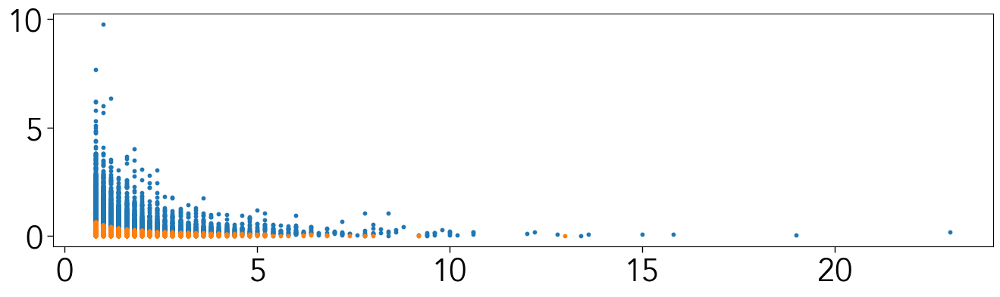

In [85]:
fig,ax = plt.subplots(figsize=(16,4))

ax.scatter(dists[np.where(~mask)[0]],wss[np.where(~mask)[0]]/dists[np.where(~mask)[0]],s=10)

ax.scatter(dists[np.where(mask)[0]],wss[np.where(mask)[0]]/dists[np.where(mask)[0]],s=10)

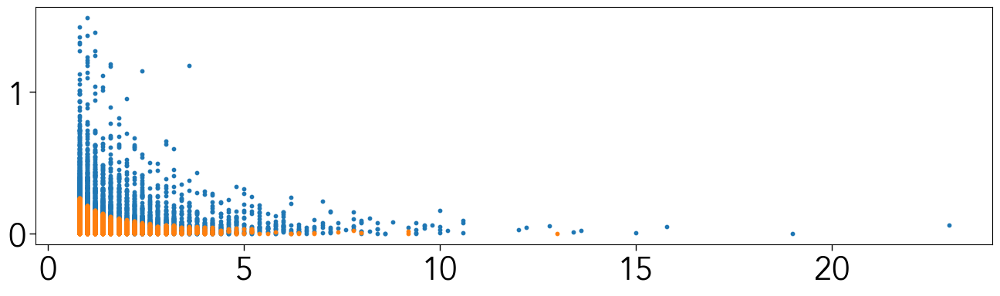

In [86]:
fig,ax = plt.subplots(figsize=(16,4))

ax.scatter(dists[np.where(~mask)[0]],ats[np.where(~mask)[0]]/dists[np.where(~mask)[0]],s=10)

ax.scatter(dists[np.where(mask)[0]],ats[np.where(mask)[0]]/dists[np.where(mask)[0]],s=10)

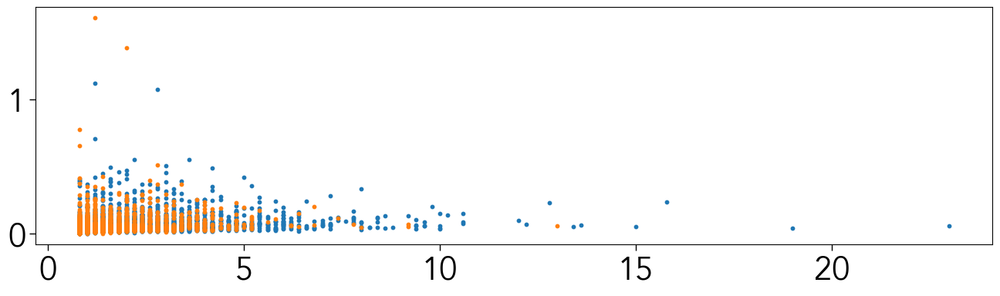

In [87]:
fig,ax = plt.subplots(figsize=(16,4))

ax.scatter(dists[np.where(~mask)[0]],ssts[np.where(~mask)[0]]/dists[np.where(~mask)[0]],s=10)

ax.scatter(dists[np.where(mask)[0]],ssts[np.where(mask)[0]]/dists[np.where(mask)[0]],s=10)

<Axes: >

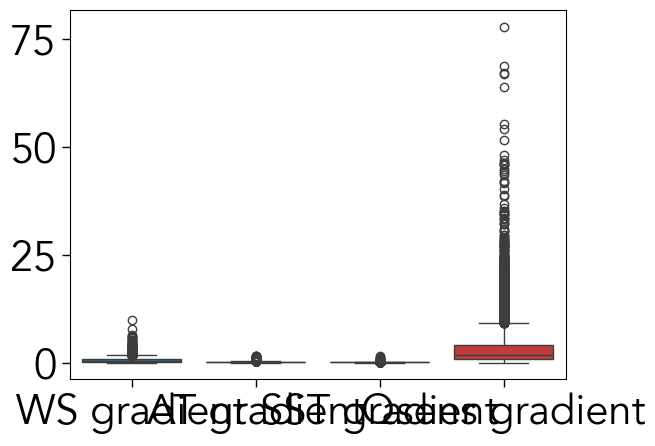

In [102]:
sns.boxplot(data=df[["WS gradient","AT gradient","SST gradient","Qsens gradient"]])

<Axes: >

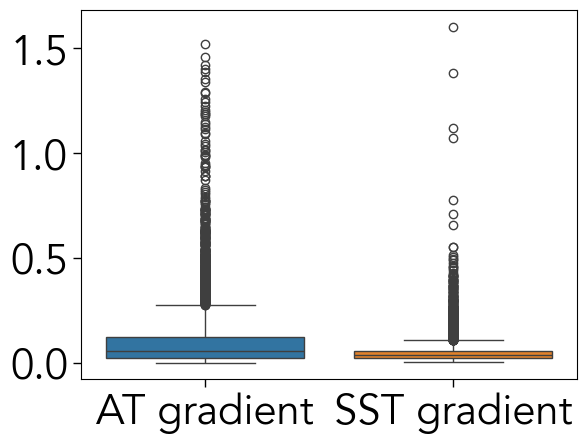

In [104]:
sns.boxplot(data=df[["AT gradient","SST gradient"]])

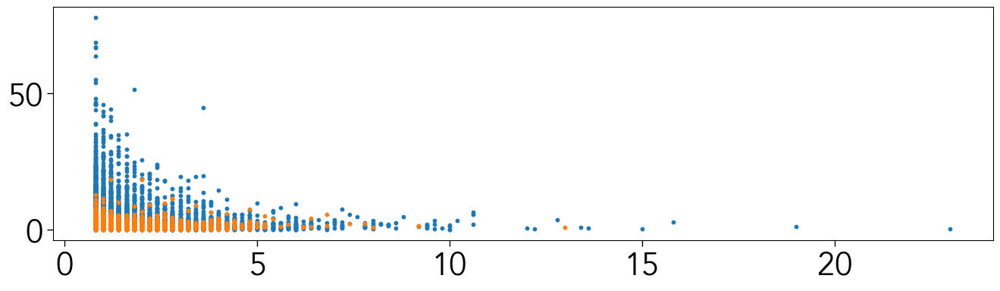

In [88]:
fig,ax = plt.subplots(figsize=(16,4))

ax.scatter(dists[np.where(~mask)[0]],means[np.where(~mask)[0]]/dists[np.where(~mask)[0]],s=10)

ax.scatter(dists[np.where(mask)[0]],means[np.where(mask)[0]]/dists[np.where(mask)[0]],s=10)

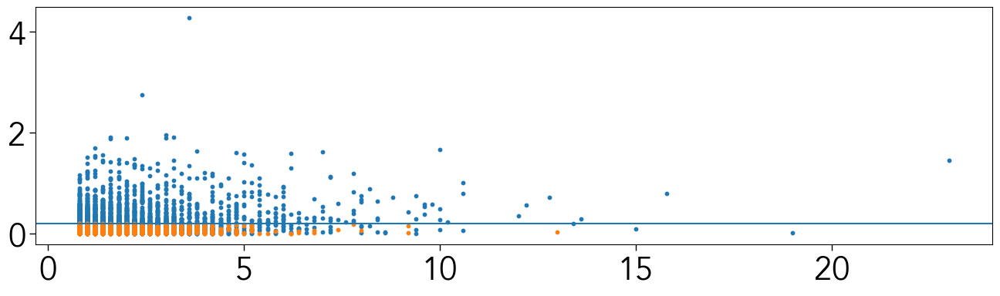

In [80]:
fig,ax = plt.subplots(figsize=(16,4))

ax.scatter(dists[np.where(~mask)[0]],ats[np.where(~mask)[0]],s=10)
ax.scatter(dists[np.where(mask)[0]],ats[np.where(mask)[0]],s=10)

ax.axhline(0.2)

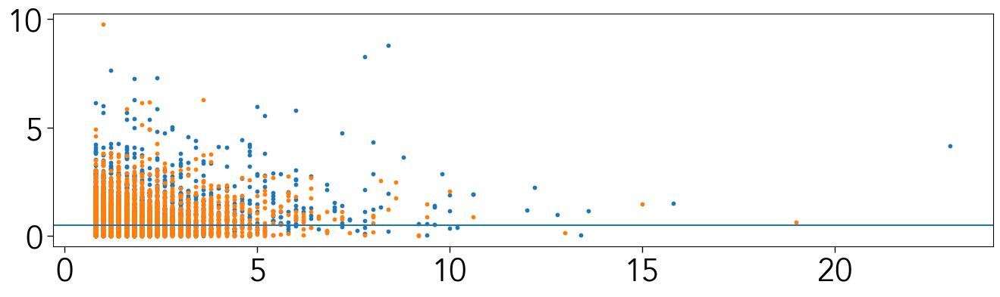

In [68]:
fig,ax = plt.subplots(figsize=(16,4))

ax.scatter(dists[np.where(ats>=0.2)[0]],wss[np.where(ats>=0.2)[0]],s=10)
ax.scatter(dists[np.where((ats<0.2) or (wss<0.5))[0]],wss[np.where((ats<0.2) or (wss<0.5))[0]],s=10)

ax.axhline(0.5)

In [52]:
fig,ax = plt.subplots()splt.scatter(dists[mask],wss[mask])
plt.scatter(dists[~mask],wss[~mask])

AttributeError: module 'matplotlib.pyplot' has no attribute 'subplotsplt'

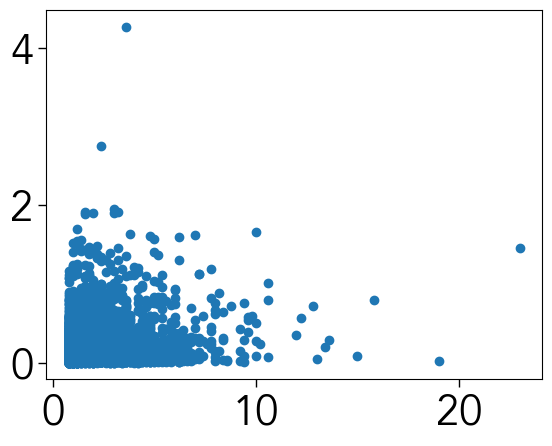

In [48]:
plt.scatter(dists,ats)

In [146]:
0.0125 * 100

1.25

In [138]:
# Define criteria thresholds for various variables
sst_criteria = 0.0125  # Threshold for sea surface temperature gradient
at_criteria = 0.2      # Threshold for air temperature change
ws_criteria = 0.5      # Threshold for wind speed change

# Process datasets with the count_fronts function using the sst_criteria
dists20, means20, start20, end20, sst20, at20, ws20 = count_fronts(ds20, sst_criteria)
dists22, means22, start22, end22, sst22, at22, ws22 = count_fronts(ds22, sst_criteria)
dists23, means23, start23, end23, sst23, at23, ws23 = count_fronts(ds23, sst_criteria)

# Concatenate results from different datasets
dists = np.concatenate([dists20, dists22, dists23])
means  = np.abs(np.concatenate([means20, means22, means23]))
ssts  = np.abs(np.concatenate([sst20, sst22, sst23]))
ats   = np.abs(np.concatenate([at20, at22, at23]))
wss   = np.abs(np.concatenate([ws20, ws22, ws23]))
starts   = np.concatenate([start20, start22, start23])
ends   = np.concatenate([end20, end22, end23])

# Create a mask for values that exceed the criteria thresholds
mask = np.logical_and(wss < ws_criteria, ats < at_criteria)

# Create a DataFrame with the calculated values and gradients
df = pd.DataFrame({
    'Distance': dists.round(1),
    'WS': wss,
    'AT': ats,
    'SST': ssts,
    'Qsens': means,
    'WS gradient': wss / dists,
    'AT gradient': ats / dists,
    'SST gradient': ssts / dists,
    'Qsens gradient': means / dists,
    'Calm': mask,  # Calm indicates where the mask condition is not met
    'Start': starts,  # Calm indicates where the mask condition is not met
    "Ends": ends  # Calm indicates where the mask condition is not met
})

# Print the descriptive statistics of the full DataFrame, rounding to 3 decimal places
print(df.where(df["Calm"]==True).dropna().describe().round(3))
print(df.where(df["Calm"]==False).dropna().describe().round(3))

# Define bin edges
bins = [0.5, 1, 1.5, 2, 2.5, 3, 3.5, 4, float('inf')]
bin_labels = [0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.75, 4.25]

# # Use pd.cut to categorize the distances into bins
# df["Distance_Binned"] = pd.cut(df["Distance"], bins=bins, right=False)
# df_calm["Distance_Binned"] = pd.cut(df_calm["Distance"], bins=bins, right=False)

df["Distance_Binned"] = pd.cut(df["Distance"], bins=bins, labels=bin_labels, right=False).astype(float)

df["Drone"] = np.concatenate([["SD1020"]*len(dists20),["SD1022"]*len(dists22),["SD1023"]*len(dists23)])

       Distance        WS        AT       SST     Qsens  WS gradient  \
count  3658.000  3658.000  3658.000  3658.000  3658.000     3658.000   
mean      1.147     0.231     0.058     0.067     1.985        0.266   
std       0.863     0.145     0.049     0.133     2.723        0.210   
min       0.600     0.000     0.000     0.000     0.000        0.000   
25%       0.600     0.106     0.020     0.014     0.524        0.095   
50%       0.800     0.219     0.044     0.026     1.193        0.213   
75%       1.350     0.358     0.088     0.062     2.486        0.395   
max      12.800     0.500     0.200     3.000    38.118        0.832   

       AT gradient  SST gradient  Qsens gradient      Start       Ends  
count     3658.000      3658.000        3658.000   3658.000   3658.000  
mean         0.064         0.046           1.839  29828.232  29833.965  
std          0.062         0.061           1.887  18423.850  18423.813  
min          0.000         0.000           0.000     19.000

In [139]:
df.where(df["Calm"]==True).drop(columns=["Start","Ends","Distance_Binned"]).dropna().describe().round(3)


,Distance,WS,AT,SST,Qsens,WS gradient,AT gradient,SST gradient,Qsens gradient
count,3658.000,3658.000,3658.000,3658.000,3658.000,3658.000,3658.000,3658.000,3658.000
mean,1.147,0.231,0.058,0.067,1.985,0.266,0.064,0.046,1.839
std,0.863,0.145,0.049,0.133,2.723,0.210,0.062,0.061,1.887
min,0.600,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
25%,0.600,0.106,0.020,0.014,0.524,0.095,0.017,0.020,0.578
50%,0.800,0.219,0.044,0.026,1.193,0.213,0.043,0.030,1.279
75%,1.350,0.358,0.088,0.062,2.486,0.395,0.089,0.050,2.445
max,12.800,0.500,0.200,3.000,38.118,0.832,0.332,1.530,20.290


In [146]:
df["Distance"].dropna().sum()

11839.0

In [147]:
df["Distance"].dropna().sum()/(ds20.distance[-1] + ds22.distance[-1] + ds23.distance[-1])

<xarray.DataArray 'distance' ()> Size: 8B
array(0.35426591)
Coordinates:
    distance  float64 8B 1.277e+04

In [140]:
df.where(df["Calm"]==False).drop(columns=["Start","Ends","Distance_Binned"]).dropna().describe().round(3)


,Distance,WS,AT,SST,Qsens,WS gradient,AT gradient,SST gradient,Qsens gradient
count,4473.000,4473.000,4473.000,4473.000,4473.000,4473.000,4473.000,4473.000,4473.000
mean,1.620,1.089,0.189,0.112,6.738,0.972,0.149,0.053,5.536
std,1.455,0.789,0.240,0.203,8.419,0.815,0.189,0.062,7.187
min,0.600,0.001,0.000,0.001,0.000,0.002,0.000,0.002,0.000
25%,0.800,0.622,0.041,0.019,1.711,0.419,0.034,0.023,1.296
50%,1.200,0.872,0.110,0.044,4.081,0.799,0.086,0.036,3.149
75%,2.000,1.327,0.241,0.114,8.281,1.283,0.192,0.061,6.975
max,22.800,9.743,4.278,3.783,161.520,12.179,1.802,1.825,81.314


In [129]:
df.dropna().describe().round(3)

,Distance,SST,AT,WS,Qsens,SST gradient,AT gradient,WS gradient,Qsens gradient,Start,Ends,Distance_Binned
count,8131.000,8131.000,8131.000,8131.000,8131.000,8131.000,8131.000,8131.000,8131.000,8131.000,8131.000,8131.000
mean,1.407,0.092,0.130,0.703,4.600,0.050,0.111,0.655,3.873,28730.128,28737.162,1.422
std,1.247,0.177,0.192,0.731,6.922,0.062,0.152,0.713,5.779,19002.433,19002.381,0.933
min,0.600,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,14.000,0.750
25%,0.600,0.016,0.028,0.219,0.869,0.021,0.025,0.187,0.854,12214.500,12217.500,0.750
50%,1.000,0.034,0.070,0.493,2.263,0.033,0.061,0.439,1.976,26231.000,26234.000,1.250
75%,1.600,0.088,0.151,0.931,5.463,0.057,0.137,0.871,4.474,45309.500,45312.500,1.750
max,22.800,3.783,4.278,9.743,161.520,1.825,1.802,12.179,81.314,65272.000,65280.000,4.250


In [124]:
ds20["sensible"]

<xarray.DataArray 'sensible' (distance: 37921)> Size: 303kB
array([ 7.21636 ,  8.565387, 10.240847, ...,  0.013402, -0.07216 , -0.094594])
Coordinates:
  * distance  (distance) float64 303kB 0.0 0.2 0.4 ... 7.584e+03 7.584e+03

In [128]:
np.abs(ds20["sens_grad"]).mean()

<xarray.DataArray 'sens_grad' ()> Size: 8B
array(4.02109114)

In [15]:
start20

array([    0,    38,   118, ..., 37762, 37819, 37838])

In [16]:
end20

array([   14,    43,   129, ..., 37769, 37827, 37847])

In [25]:
np.nanmean(np.abs(ds20["sens_grad"].isel(distance=result)))

4.1312140785629685

In [98]:
np.nanmean(np.abs(ds20["sens_grad"].isel(distance=result)))

4.1312140785629685

In [23]:
result = np.concatenate([np.arange(start, end + 1) for start, end in zip(start20, end20)])

In [197]:
# Create a single array with all indices between start20 and end20
fronts     = np.concatenate([np.arange(start, end) for start, end in zip(start20, end20)])
non_fronts = np.concatenate([np.arange(start, end) for start, end in zip(end20, np.insert(start20[1:],len(start20)-1,37921))])


(0.0, 20.0)

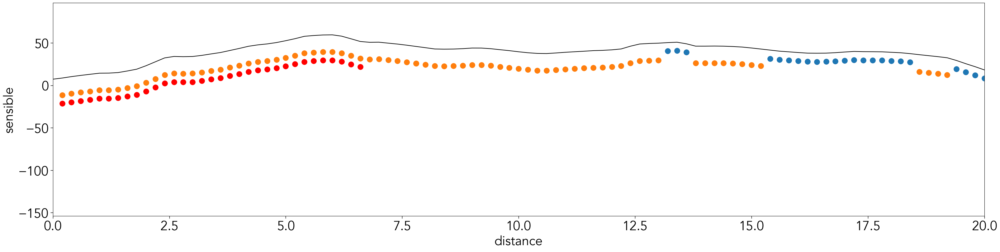

In [195]:
fig, axs = plt.subplots(figsize=(32,8),constrained_layout=True)


(ds20.isel(distance=non_fronts)["sensible"]-10).plot(c="C0", lw=0, marker=".",zorder=2,ax=axs,ms=25)
(ds20.isel(distance=fronts)["sensible"]-20).plot(c="C1", lw=0, marker=".",zorder=2,ax=axs,ms=25)
ds20["sensible"].plot(c="k",zorder=1,ax=axs)

(ds20["sensible"].isel(distance=slice(start20[0],end20[0]+1))-30).plot(c="r", lw=0, marker=".",zorder=3,ax=axs,ms=25)
(ds20["sensible"].isel(distance=slice(start20[1],end20[1]+1))-30).plot(c="r", lw=0, marker=".",zorder=3,ax=axs,ms=25)

axs.set_xlim(0,20)

In [192]:
start20.sort()

In [171]:
np.intersect1d(fronts,non_fronts)

array([], dtype=int64)

In [193]:
end20.sort()

(0.0, 20.0)

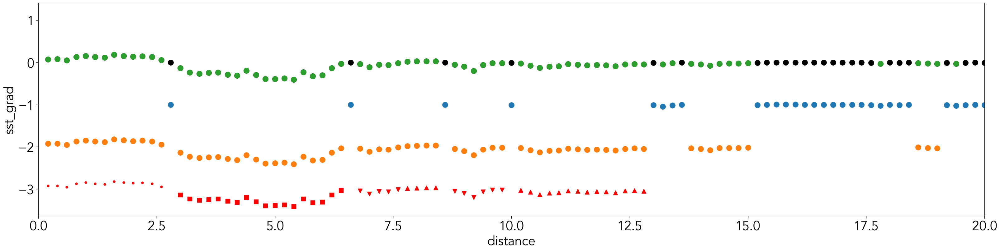

In [198]:
fig, axs = plt.subplots(figsize=(32,8),constrained_layout=True)


(ds20.isel(distance=non_fronts)["sst_grad"]-1).plot(c="C0", lw=0, marker=".",zorder=2,ax=axs,ms=25)
(ds20.isel(distance=fronts)["sst_grad"]-2).plot(c="C1", lw=0, marker=".",zorder=2,ax=axs,ms=25)
ds20["sst_grad"].plot(c="k",zorder=1,ax=axs, lw=0, marker=".",ms=25)
ds20["sst_grad"].where(np.abs(ds20["sst_grad"])> 0.0125).plot(c="C2",zorder=1,ax=axs, lw=0, marker=".",ms=25)

(ds20["sst_grad"].isel(distance=slice(start20[0],end20[0]))-3).plot(c="r", lw=0, marker=".",zorder=3,ax=axs,ms=10)
(ds20["sst_grad"].isel(distance=slice(start20[1],end20[1]))-3).plot(c="r", lw=0, marker="s",zorder=3,ax=axs,ms=10)
(ds20["sst_grad"].isel(distance=slice(start20[2],end20[2]))-3).plot(c="r", lw=0, marker="v",zorder=3,ax=axs,ms=10)
(ds20["sst_grad"].isel(distance=slice(start20[3],end20[3]))-3).plot(c="r", lw=0, marker="^",zorder=3,ax=axs,ms=10)
(ds20["sst_grad"].isel(distance=slice(start20[4],end20[4]))-3).plot(c="r", lw=0, marker="v",zorder=3,ax=axs,ms=10)
(ds20["sst_grad"].isel(distance=slice(start20[5],end20[5]))-3).plot(c="r", lw=0, marker="^",zorder=3,ax=axs,ms=10)

axs.set_xlim(0,20)

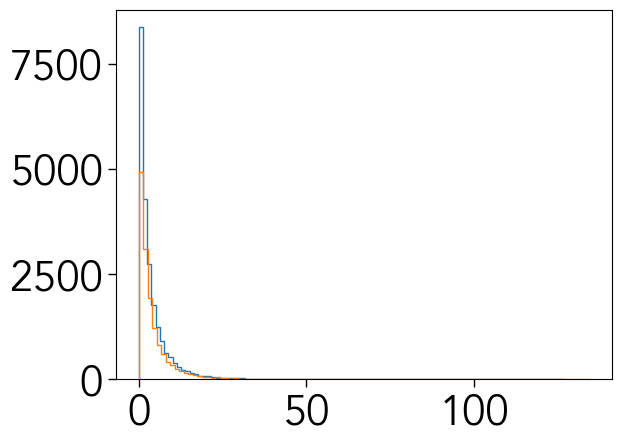

In [199]:
_=plt.hist(np.abs(ds20["sens_grad"][non_fronts]),bins=100,histtype="step")
_=plt.hist(np.abs(ds20["sens_grad"][fronts]),bins=100,histtype="step")

In [200]:
np.nanmean(np.abs(ds20["sens_delta"][non_fronts]))

0.7760547484513255

In [201]:
np.nanmean(df["Qsens"].dropna()) / np.nanmean(np.abs(ds20["sens_delta"][non_fronts]))

5.927312535994457

In [202]:
np.nanmean(np.abs(ds20["sens_grad"][non_fronts]))

3.8802737422566276

In [203]:
np.nanmean(np.abs(ds20["sens_delta"][non_fronts]))

0.7760547484513255

In [204]:
np.nanstd(ds20["sens_delta"][non_fronts])

1.352091205965822

In [205]:
np.nanmean(np.abs(ds20["sens_delta"][fronts]))

0.8472783467418044

In [206]:
np.nanmean(np.abs(ds20["sens_grad"][fronts])) / np.nanmean(np.abs(ds20["sens_grad"][non_fronts]))

1.0917765124594763

In [207]:
df.dropna().groupby("Distance_Binned")["Qsens gradient"].mean() / np.nanmean(np.abs(ds20["sens_grad"][non_fronts]))

Distance_Binned
0.75    1.203106
1.25    0.940567
1.75    0.807766
2.25    0.765092
2.75    0.625082
3.25    0.750046
3.75    0.645898
4.25    0.541551
Name: Qsens gradient, dtype: float64

In [208]:
df.dropna().groupby("Distance_Binned")["Qsens gradient"].mean()

Distance_Binned
0.75    4.668379
1.25    3.649657
1.75    3.134355
2.25    2.968765
2.75    2.425490
3.25    2.910385
3.75    2.506261
4.25    2.101365
Name: Qsens gradient, dtype: float64

In [219]:
(np.nanmean(np.abs(ds20["sens_grad"][fronts]))/np.nanmean(np.abs(ds20["sens_grad"][non_fronts]))).round(1)

1.1

In [220]:
df.dropna().groupby("Distance_Binned")["SST gradient"].mean()

Distance_Binned
0.75    0.031771
1.25    0.051769
1.75    0.063049
2.25    0.073563
2.75    0.088329
3.25    0.088331
3.75    0.092659
4.25    0.091950
Name: SST gradient, dtype: float64

In [221]:
np.nanmean(np.abs(ds20["sst_grad"][fronts]))

0.06661283335776413

In [211]:
df.dropna().groupby("Distance_Binned")["Qsens gradient"].mean() / np.nanmean(np.abs(ds20["sens_grad"][non_fronts]))

Distance_Binned
0.75    1.203106
1.25    0.940567
1.75    0.807766
2.25    0.765092
2.75    0.625082
3.25    0.750046
3.75    0.645898
4.25    0.541551
Name: Qsens gradient, dtype: float64

In [214]:
df.dropna()["Qsens gradient"].mean()

3.8725811946544053

In [210]:
((df.dropna().groupby("Distance_Binned")["Qsens"].mean() / df.dropna().groupby("Distance_Binned")["Distance_Binned"].mean()) / np.nanmean(np.abs(ds20["sens_grad"][non_fronts])) ).round(2) - 1

Distance_Binned
0.75    0.07
1.25   -0.13
1.75   -0.22
2.25   -0.26
2.75   -0.39
3.25   -0.26
3.75   -0.37
4.25   -0.30
dtype: float64

In [91]:
print(df["Qsens"].dropna().describe().round(3))

count    8129.000
mean        4.958
std         7.260
min         0.001
25%         0.987
50%         2.533
75%         5.909
max       161.518
Name: Qsens, dtype: float64


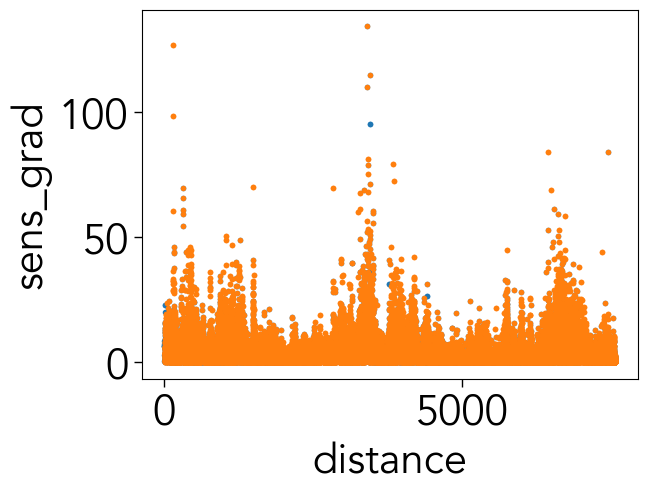

In [79]:
np.abs(ds20["sens_grad"][fronts]).plot(marker=".", ls="")
np.abs(ds20["sens_grad"][non_fronts]).plot(marker=".", ls="")

In [70]:
np.abs(ds20["sst_grad"][non_fronts]).median()

<xarray.DataArray 'sst_grad' ()> Size: 8B
array(0.00940886)

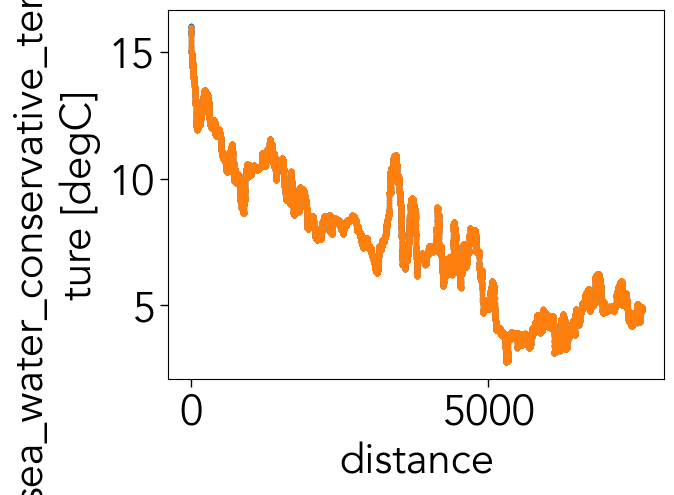

In [55]:
ds20["sst"][fronts].plot(ls="",marker=".")
ds20["sst"][non_fronts].plot(ls="",marker=".")

In [24]:
result

array([    0,     1,     2, ..., 37845, 37846, 37847])

In [12]:
from scipy.stats import linregress

In [22]:
linregress(sst20,ws20)

LinregressResult(slope=nan, intercept=nan, rvalue=nan, pvalue=nan, stderr=nan, intercept_stderr=nan)

In [10]:
winds = np.concatenate([ws20,ws22,ws23])
seats = np.concatenate([sst20,sst22,sst23])
airts = np.concatenate([at20,at22,at23])
senss = np.concatenate([means20,means22,means23])

In [13]:

for v,n in zip([winds,airts,senss],["Winds","Air T", "Sensible"]):

    print(f"{n}:")
    mask = np.logical_and(np.isfinite(seats),np.isfinite(v))    
    print(linregress(seats[mask],v[mask]))

Winds:
LinregressResult(slope=0.05061193794560376, intercept=-0.0071865780941028756, rvalue=0.00989616830080245, pvalue=0.36592754794990434, stderr=0.05597568544314561, intercept_stderr=0.011068052527156376)
Air T:
LinregressResult(slope=0.19481372370329642, intercept=-0.0003306203770254717, rvalue=0.16660469067452394, pvalue=3.072949442413041e-52, stderr=0.01271852182519616, intercept_stderr=0.00252596257824727)
Sensible:
LinregressResult(slope=-15.486428514852335, intercept=0.011091313794467567, rvalue=-0.3708821159293475, pvalue=1.4475346149143733e-263, stderr=0.43009351016186764, intercept_stderr=0.0856254311344054)


In [34]:

for v,n in zip([winds,airts,seats],["Winds","Air T", "SST"]):

    print(f"{n}:")
    mask = np.logical_and(np.isfinite(senss),np.isfinite(v))    
    print(linregress(senss[mask],v[mask]))

Winds:
LinregressResult(slope=-0.04927317301315067, intercept=-0.00958857934973503, rvalue=-0.4045887865645882, pvalue=0.0, stderr=0.001235420096346907, intercept_stderr=0.010860861656969452)
Air T:
LinregressResult(slope=0.016073282721047015, intercept=-0.00012119265289000335, rvalue=0.571016996389262, pvalue=0.0, stderr=0.0002563308651293599, intercept_stderr=0.0022534634759571945)
SST:
LinregressResult(slope=-0.008575518820281614, intercept=0.003487205651193818, rvalue=-0.3662012464951583, pvalue=1.8889654727794348e-256, stderr=0.00024171771785343172, intercept_stderr=0.0021249959438148247)


In [35]:

for v,n in zip([wss,ats,ssts],["Winds","Air T", "SST"]):

    print(f"{n}:")
    mask = np.logical_and(np.isfinite(senss),np.isfinite(v))    
    print(linregress(means[mask],v[mask]))

Winds:
LinregressResult(slope=0.046343102015175636, intercept=0.5208593252425291, rvalue=0.44069110219948643, pvalue=0.0, stderr=0.0010471212897914543, intercept_stderr=0.009205483624656011)
Air T:
LinregressResult(slope=0.017312870638785754, intercept=0.05567322757384707, rvalue=0.619145023351451, pvalue=0.0, stderr=0.00024357586852709752, intercept_stderr=0.0021413313729244554)
SST:
LinregressResult(slope=0.008367112979632843, intercept=0.05853114620802027, rvalue=0.33750176802969356, pvalue=9.989564033244639e-216, stderr=0.0002588653933547599, intercept_stderr=0.002275745095386205)


In [62]:
# Adjust the mask logic if needed
mask = np.logical_or(wss > ws_criteria, ats > at_criteria)  # Modify logic as per your intent

# Ensure no division by zero in gradient calculations
with np.errstate(divide='ignore', invalid='ignore'):
    sst_gradient = np.where(dists != 0, ssts / dists, 0)
    at_gradient = np.where(dists != 0, ats / dists, 0)
    ws_gradient = np.where(dists != 0, wss / dists, 0)
    qsens_gradient = np.where(dists != 0, means / dists, 0)

# Create the DataFrame
df = pd.DataFrame({
    'Distance': dists.round(1),
    'SST': ssts,
    'AT': ats,
    'WS': wss,
    'Qsens': means,
    'SST gradient': sst_gradient,
    'AT gradient': at_gradient,
    'WS gradient': ws_gradient,
    'Qsens gradient': qsens_gradient,
    'Calm': ~mask,
    'Start': starts,
    'Ends': ends
})

# Use direct filtering instead of .where()
df_calm = df[df["Calm"]]
df_not_calm = df[~df["Calm"]]

# Print descriptive statistics
print(df_calm.describe().round(3))
print(df_not_calm.describe().round(3))

# Bin the distances
df["Distance_Binned"] = pd.cut(df["Distance"], bins=bins, labels=bin_labels, right=False).astype(float)

# Add drone information
df["Drone"] = np.concatenate([["SD1020"]*len(dists20), ["SD1022"]*len(dists22), ["SD1023"]*len(dists23)])

       Distance       SST        AT        WS     Qsens  SST gradient  \
count  3541.000  3541.000  3413.000  3463.000  3335.000      3541.000   
mean      1.371     0.078     0.061     0.229     2.145         0.048   
std       0.871     0.129     0.051     0.144     2.833         0.059   
min       0.800     0.000     0.000     0.000     0.001         0.001   
25%       0.800     0.020     0.020     0.104     0.578         0.021   
50%       1.000     0.036     0.046     0.217     1.339         0.031   
75%       1.600     0.079     0.091     0.352     2.696         0.053   
max      13.000     2.767     0.200     0.500    38.126         1.604   

       AT gradient  WS gradient  Qsens gradient      Start       Ends  
count     3413.000     3463.000        3335.000   3541.000   3541.000  
mean         0.053        0.207           1.587  30806.027  30812.882  
std          0.049        0.156           1.571  18407.490  18407.372  
min          0.000        0.000           0.001     18

In [411]:
df.drop(columns="Drone").corr?

Object `corr` not found.


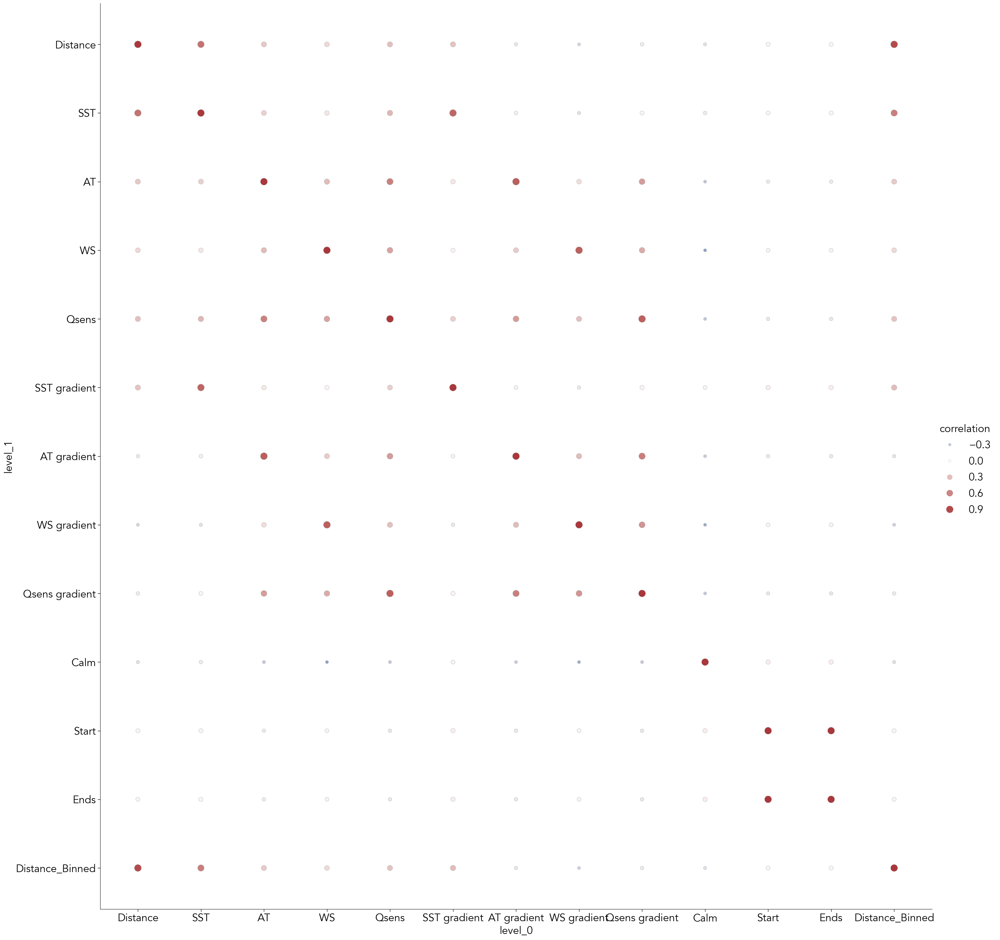

In [405]:
# Draw each cell as a scatter point with varying size and color

g = sns.relplot(
    data=df.drop(columns="Drone").corr().stack().reset_index(name="correlation"),
    x="level_0", y="level_1", hue="correlation", size="correlation",
    palette="vlag", hue_norm=(-1, 1), edgecolor=".7",
    height=30, sizes=(50, 250), size_norm=(-.2, .8)
)

In [240]:
df.iloc[df["SST"].argmax()]

Distance                15.8
SST                 3.787787
AT                   0.80089
WS                   1.51488
Qsens              45.670344
SST gradient        0.239733
AT gradient         0.050689
WS gradient         0.095878
Qsens gradient      2.890528
Calm                   False
Start                   6134
Ends                    6213
Distance_Binned         4.25
Drone                 SD1023
Name: 5481, dtype: object

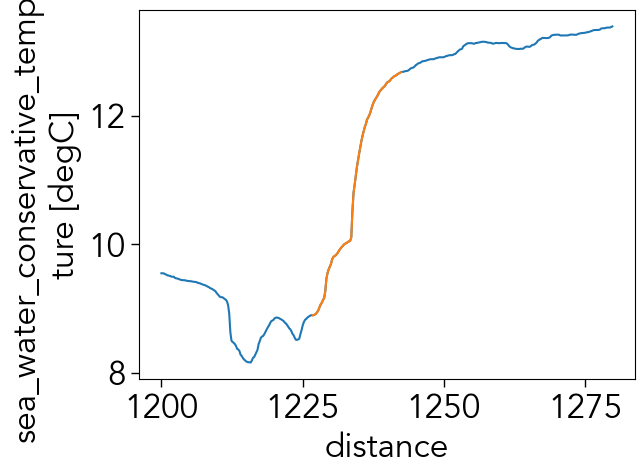

In [245]:
ds23.isel(distance=slice(6000,6400))["sst"].plot()
ds23.isel(distance=slice(6134,6213))["sst"].plot()

In [246]:
df.iloc[df["Qsens"].argmax()]

Distance                  3.6
SST                  0.586122
AT                   4.277694
WS                   0.112806
Qsens              161.518314
SST gradient         0.162812
AT gradient          1.188248
WS gradient          0.031335
Qsens gradient      44.866198
Calm                    False
Start                    3735
Ends                     3753
Distance_Binned          3.75
Drone                  SD1022
Name: 2008, dtype: object

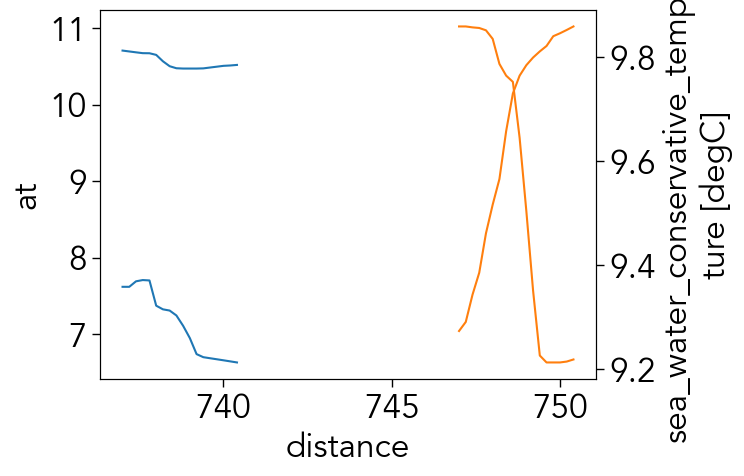

In [250]:
ds22.isel(distance=slice(3735-50,3753-50))["at"].plot()
ds22.isel(distance=slice(3735,3753))["at"].plot()

bx = plt.gca().twinx()

ds22.isel(distance=slice(3735-50,3753-50))["sst"].plot(ax=bx)
ds22.isel(distance=slice(3735,3753))["sst"].plot(ax=bx)

In [251]:
df.iloc[df["Distance"].argmax()]

Distance                23.0
SST                 1.396331
AT                  1.458692
WS                  4.149885
Qsens              10.024727
SST gradient         0.06071
AT gradient         0.063421
WS gradient          0.18043
Qsens gradient      0.435858
Calm                   False
Start                  58572
Ends                   58687
Distance_Binned         4.25
Drone                 SD1023
Name: 8252, dtype: object

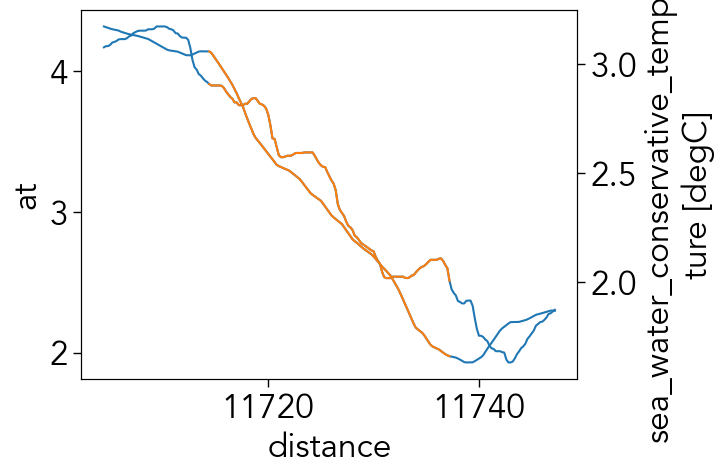

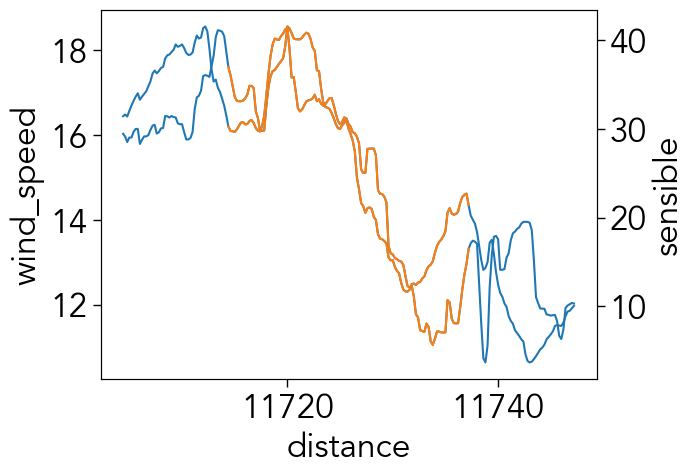

In [255]:
plt.figure()
ds23.isel(distance=slice(58572-50,58687+50))["at"].plot()
ds23.isel(distance=slice(58572,58687))["at"].plot()

bx = plt.gca().twinx()

ds23.isel(distance=slice(58572-50,58687+50))["sst"].plot(ax=bx)
ds23.isel(distance=slice(58572,58687))["sst"].plot(ax=bx)

plt.figure()
ds23.isel(distance=slice(58572-50,58687+50))["wind_speed"].plot()
ds23.isel(distance=slice(58572,58687))["wind_speed"].plot()

bx = plt.gca().twinx()

ds23.isel(distance=slice(58572-50,58687+50))["sensible"].plot(ax=bx)
ds23.isel(distance=slice(58572,58687))["sensible"].plot(ax=bx)


<Axes: xlabel='Distance', ylabel='SST'>

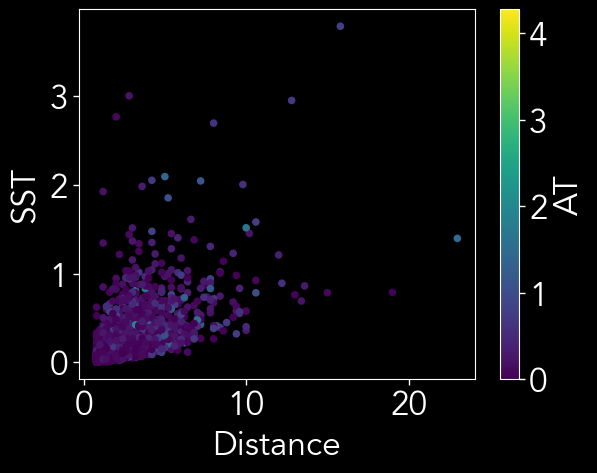

In [29]:
df.plot.scatter(x="Distance",y="SST",c="AT")

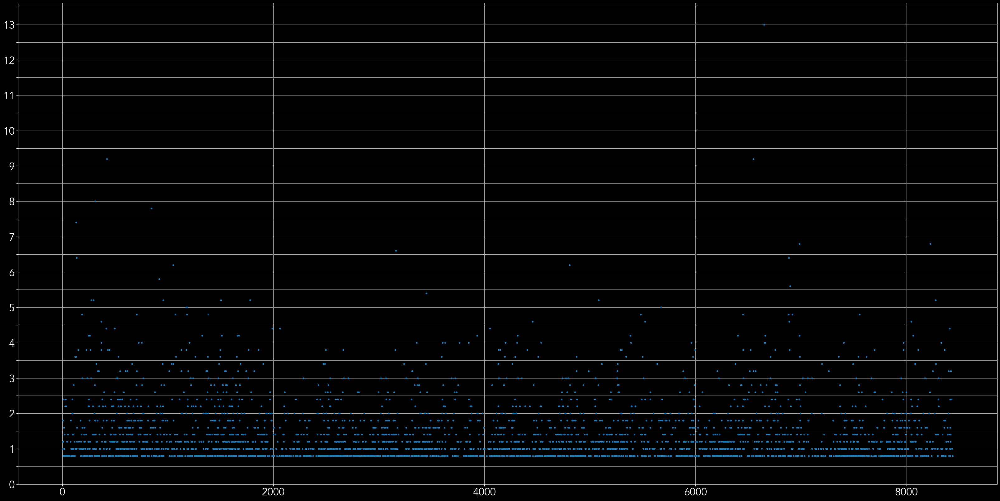

In [21]:
fig,ax = plt.subplots(figsize=(32,16),constrained_layout=True)

df_calm["Distance"].plot(marker="o",ls="",ms=3,ax=ax)
ax.set_yticks(np.arange(0,14,1))
ax.set_yticks(np.arange(0.5,14,0.5),minor=True)
ax.grid(which="both")

In [10]:
def dataframe_to_latex(df, caption, label):
    """
    Convert a pandas DataFrame to a LaTeX table string.
    
    Parameters:
    df (pd.DataFrame): The DataFrame to convert.
    caption (str): The caption for the table.
    label (str): The label for the table.
    
    Returns:
    str: LaTeX table string.
    """
    # Function to escape LaTeX special characters
    def escape_latex(text):
        return str(text).replace('%', '\\%')

    # Create the beginning of the table
    latex_str = f"""
\\begin{{table}}[ht]
\\centering
\\caption{{{caption}}}
\\label{{{label}}}
\\resizebox{{\\linewidth}}{{!}}{{%
\\begin{{tabular}}{{l{'c' * len(df.columns)}}}
"""
                    
    # Add column headers
    headers = ' & '.join(map(escape_latex, df.columns))
    latex_str += f"\\multicolumn{{1}}{{l}}{{}} & {headers} \\\\ \\hline\n"
    
    # Add rows of data
    for idx, row in df.iterrows():
        row_str = ' & '.join(map(escape_latex, row.values if idx != "count" else row.values.astype(int)))
        latex_str += f"{escape_latex(idx.capitalize())} & {row_str} \\\\ \\hline\n"
    
    # Close the table
    latex_str += """
\\end{tabular}%
}
\\end{table}
"""
    
    print(latex_str)

In [13]:
caption = "Statistical summary of the different frontal parameters during stable atmospheric conditions. The actual displacement from the start to the end of the front is labeled Distance, the changes in sea surface and air temperature, wind speed, and \qsens over the front are $\Delta$SST, $\Delta$AT, $\Delta$WS, and $\Delta$\qsens, respectively. The gradients across each front are represented as \ddx of each variable."

In [14]:
dataframe_to_latex(np.round(df_calm.dropna().describe(),3), caption, "tab:front_stats")


\begin{table}[ht]
\centering
\caption{Statistical summary of the different frontal parameters during stable atmospheric conditions. The actual displacement from the start to the end of the front is labeled Distance, the changes in sea surface and air temperature, wind speed, and \qsens over the front are $\Delta$SST, $\Delta$AT, $\Delta$WS, and $\Delta$\qsens, respectively. The gradients across each front are represented as \ddx of each variable.}
\label{tab:front_stats}
\resizebox{\linewidth}{!}{%
\begin{tabular}{lccccccccc}
\multicolumn{1}{l}{} & Distance & SST & AT & WS & Qsens & SST gradient & AT gradient & WS gradient & Qsens gradient \\ \hline
Count & 3335 & 3335 & 3335 & 3335 & 3335 & 3335 & 3335 & 3335 & 3335 \\ \hline
Mean & 1.369 & 0.077 & 0.061 & 0.23 & 2.145 & 0.047 & 0.053 & 0.208 & 1.587 \\ \hline
Std & 0.876 & 0.131 & 0.05 & 0.143 & 2.833 & 0.059 & 0.049 & 0.156 & 1.571 \\ \hline
Min & 0.8 & 0.0 & 0.0 & 0.0 & 0.001 & 0.001 & 0.0 & 0.0 & 0.001 \\ \hline
25\% & 0.8 & 0.02

In [15]:
# df["Distance"] = (np.round(df["Distance"] * 5) / 5) + 0.1
# df.loc[df["Distance"] >= 4,"Distance"] = 4.1

# df_calm["Distance"] = (np.round(df_calm["Distance"] * 5) / 5) + 0.1
# df_calm.loc[df_calm["Distance"] >= 4,"Distance"] = 4.1

# df["Drone"] = np.concatenate([["SD1020"]*len(dists20),["SD1022"]*len(dists22),["SD1023"]*len(dists23)])

In [22]:
start20.sort()
end20.sort()

[Text(0.5, 0, 'Distance (km)'),
 Text(0, 0.5, 'Sea surface temperature gradient (°C km$^{-1}$)')]

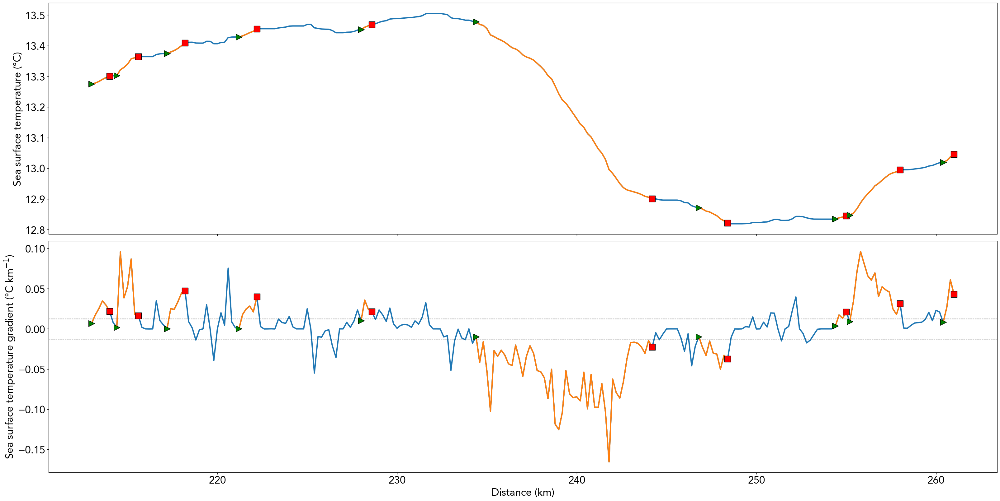

In [52]:
fig,ax = plt.subplots(2,1,figsize=(32,16),constrained_layout=True,sharex=True)

n = 10
k = 80
S = 200

ds20.isel(distance=slice(start20[k],start20[k+n]))["sst"].plot(ax=ax[0],lw=3)
ds20.isel(distance=slice(start20[k],start20[k+n]))["sst_grad"].plot(ax=ax[1],lw=3)

ax[1].axhline(0.0125,lw=1,ls="--",c="k")
ax[1].axhline(-0.0125,lw=1,ls="--",c="k")

for s,e in zip(start20[k:k+n],end20[k:k+n]):
    ds20.isel(distance=slice(s,e))["sst"].plot(ax=ax[0],c="C1",lw=3)
    ax[0].scatter(ds20.isel(distance=slice(s,e))["distance"][0].values,ds20.isel(distance=slice(s,e))["sst"][0],c="g",zorder=3,marker=">",s=S,ec="k")
    ax[0].scatter(ds20.isel(distance=slice(s,e))["distance"][-1].values,ds20.isel(distance=slice(s,e))["sst"][-1],c="r",zorder=3,marker="s",s=S,ec="k")

for s,e in zip(start20[k:k+n],end20[k:k+n]):
    ds20.isel(distance=slice(s,e))["sst_grad"].plot(ax=ax[1],c="C1",lw=3)
    ax[1].scatter(ds20.isel(distance=slice(s,e))["distance"][0].values,ds20.isel(distance=slice(s,e))["sst_grad"][0],c="g",zorder=3,marker=">",s=S,ec="k")
    ax[1].scatter(ds20.isel(distance=slice(s,e))["distance"][-1].values,ds20.isel(distance=slice(s,e))["sst_grad"][-1],c="r",zorder=3,marker="s",s=S,ec="k")

ax[0].set(xlabel="",ylabel="Sea surface temperature (°C)")
ax[1].set(xlabel="Distance (km)",ylabel="Sea surface temperature gradient (°C km$^{-1}$)")


In [9]:
df["Distance"] = (np.round(df["Distance"] * 2) / 2) - 0.25
df.loc[df["Distance"] >= 4,"Distance"] = 4.25

df_calm["Distance"] = (np.round(df_calm["Distance"] * 2) / 2) - 0.25
df_calm.loc[df_calm["Distance"] >= 4,"Distance"] = 4.25

df["Drone"] = np.concatenate([["SD1020"]*len(dists20),["SD1022"]*len(dists22),["SD1023"]*len(dists23)])

In [15]:
# Define bin edges
bins = [0.5, 1, 1.5, 2, 2.5, 3, 3.5, 4, float('inf')]
bin_labels = [0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.75, 4.25]

# # Use pd.cut to categorize the distances into bins
# df["Distance_Binned"] = pd.cut(df["Distance"], bins=bins, right=False)
# df_calm["Distance_Binned"] = pd.cut(df_calm["Distance"], bins=bins, right=False)

df["Distance_Binned"] = pd.cut(df["Distance"], bins=bins, labels=bin_labels, right=False).astype(float)
#df_calm["Distance_Binned"] = pd.cut(df_calm["Distance"], bins=bins, labels=bin_labels, right=False).astype(float)

df["Drone"] = np.concatenate([["SD1020"]*len(dists20),["SD1022"]*len(dists22),["SD1023"]*len(dists23)])

(-0.1, 100.1, -0.495, 1.595)

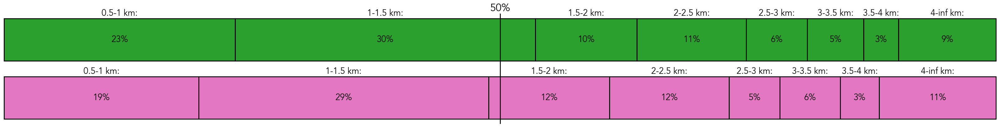

In [161]:
fig, axs = plt.subplots(1,1,figsize=(32,4),constrained_layout=True)

parts = (df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"]/df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"].sum()*100)
edges = np.insert(parts.cumsum(),0,0)

for i in range(len(parts)):
    axs.barh(y=0, left=edges[i], width=parts.iloc[i], color="C6", ec="k",lw=2)
    axs.text(edges[i] + parts.iloc[i]/2, +0.5, f"{bins[i]}-{bins[i+1]} km:", ha="center", va="center", fontsize="small")
    axs.text(edges[i] + parts.iloc[i]/2, 0, f"{int(parts.iloc[i])}%", ha="center", va="center", fontsize="small")


axs.text(50,1.65,"50%",c="k",ha="center")
#axs.text(50,-0.575,"50%",c="w",ha="center")
axs.axvline(50,c="k",ls="-",lw=2)

parts = (df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"]/df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"].sum()*100)
edges = np.insert(parts.cumsum(),0,0)

for i in range(len(parts)):
    axs.barh(y=1.1, left=edges[i], width=parts.iloc[i], color="C2", ec="k",lw=2)
    axs.text(edges[i] + parts.iloc[i]/2, 1.6, f"{bins[i]}-{bins[i+1]} km:", ha="center", va="center", fontsize="small")
    axs.text(edges[i] + parts.iloc[i]/2, 1.1, f"{int(parts.iloc[i])}%", ha="center", va="center", fontsize="small")

axs.set(xlim=(-0.1,100.1))

axs.axis("off")

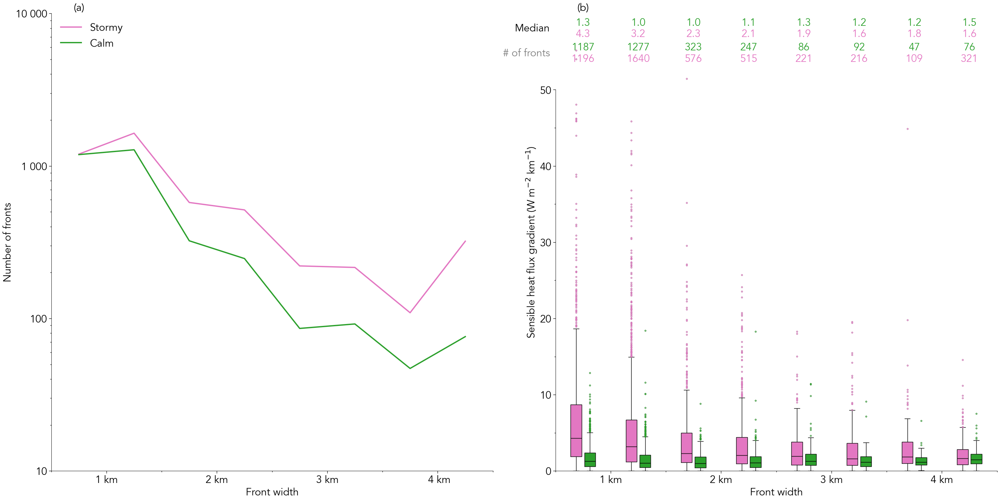

In [163]:
def plot_boxes(df, ax, ylim):
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=["C6","C2"], ax=ax, width=0.5,gap=0.2,saturation=1,
                flierprops={"marker": "."},
                boxprops={"zorder": 2, "lw":1},
                medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=["C6","C2"], ax=ax, width=0.5,gap=0.2,fill=False,
                flierprops={"marker": "."},
                whiskerprops={"color": "k","lw":1},
                capprops={"color": "k","lw":1},
                boxprops={"zorder": 2, "lw":1, "color":"k"},
                medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    ax.set(title="", xlabel="", ylabel="", ylim=ylim)

    #ax.legend(loc="upper right",bbox_to_anchor=(0.99,0.875), title="Calm atm.", reverse=True, frameon=False)
    return bp

# Create the grid specification
fig,axs = plt.subplots(1,2,figsize=(32, 16),constrained_layout=True)

ax = axs

for axs in ax:
    axs.spines['top'].set_visible(False)
    axs.spines['right'].set_visible(False)

ms=0

df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").count()["Qsens"].plot(ax=ax[0],color="C6", zorder=2,ls='-', lw=3)#, marker=".",mew=2,mec="r",mfc="r",ms=ms)
df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").count()["Qsens"].plot(ax=ax[0],color="C2", zorder=2,ls='-', lw=3)#, marker=".",mew=2,mec="r",mfc="r",ms=ms)

bp = plot_boxes(df, ax[1], (0,50))
ax[1].spines['left'].set_bounds(0,50)


medians1 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
medians2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
ns1 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens gradient"].count().values
ns2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].count().values

for m1,m2,n1,n2,x in zip(medians1,medians2,ns1,ns2,np.arange(0,22,1)):
    ax[1].text(x,58.75,m1,ha="center",va="center",fontweight="bold",c="C2")
    ax[1].text(x,57.25,m2,ha="center",va="center",fontweight="bold",c="C6")
    ax[1].text(x,55.5,n1,ha="center",va="center",c="C2")
    ax[1].text(x,54.0,n2,ha="center",va="center",c="C6")

ax[1].text(-0.6,58,"Median",ha="right",va="center",fontweight="bold")
ax[1].text(-0.6,54.75,"# of fronts",ha="right",va="center",c="grey")

ax[1].set_xlim(-0.5,7.5)
ax[1].set_xticks(np.arange(0.5,8.5,2),labels=[f"{int(j)} km" for j in np.arange(1,4.5,1)])
ax[1].set_xticks(np.arange(-0.5,8,1),minor=True)

line1 = Line2D([], [], linestyle='-',lw=3, color='C6', label='Stormy')
line2 = Line2D([], [], linestyle='-',lw=3, color='C2', label='Calm')

# Add the custom legend handles
ax[0].legend(handles=[line1, line2],loc="upper left",frameon=False)
    
# Define parameters for plotting
parameters = [
    (ax[0], "log", "Number of fronts", [1e1,1e4],[1e1,1e2,1e3,1e4],["10","100","1 000","10 000"]),
    (ax[1], "linear", r"Sensible heat flux gradient (W m$^{-2}$ km$^{-1}$)", [0,60],np.arange(0,51,10),np.arange(0,51,10))]

# Set common axis properties
for i,(axs, yscale, ylabel, ylim, yticks, ylabels) in enumerate(parameters):
    axs.set(xlabel="Front width", yscale=yscale, ylabel=ylabel,ylim=ylim)
    axs.set_yticks(yticks,labels=ylabels)
    if i < 1:
        axs.set_xticks(np.arange(1,4.5,1), labels=["1 km", "2 km", "3 km", " 4 km"])
        axs.set_xticks(np.arange(0.5,4.6,0.5),minor=True)
    #axs.grid(which="minor", zorder=1)
    #axs.grid(which="major", zorder=1)

for axs,l,x,y in zip(ax,["(a)","(b)","(c)"],[0.75,0],[1e4,60]):
    axs.text(x,y,l,ha="center",va="bottom",fontweight="bold")

ax[1].set_yticks(np.arange(0,51,5),minor=True)

white_or_black("white")

# plt.tight_layout()
# plt.savefig("../figures/front-heat-flux-boxplots.png")

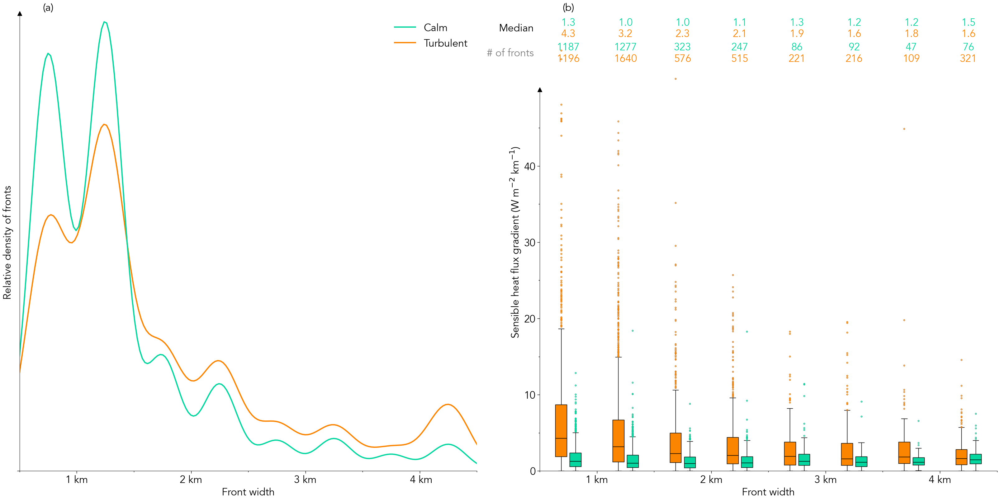

In [292]:
def plot_boxes(df, ax, ylim):
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=[c2,c1], ax=ax, width=0.5,gap=0.2,saturation=1,
                flierprops={"marker": "."},
                boxprops={"zorder": 2, "lw":1},
                medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=[c2,c1], ax=ax, width=0.5,gap=0.2,fill=False,
                flierprops={"marker": "."},
                whiskerprops={"color": "k","lw":1},
                capprops={"color": "k","lw":1},
                boxprops={"zorder": 2, "lw":1, "color":"k"},
                medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    ax.set(title="", xlabel="", ylabel="", ylim=ylim)

    #ax.legend(loc="upper right",bbox_to_anchor=(0.99,0.875), title="Calm atm.", reverse=True, frameon=False)
    return bp

# Create the grid specification
fig,axs = plt.subplots(1,2,figsize=(32, 16),constrained_layout=True)

ax = axs

# c1 = "C2"
# c2 = "C6"

# c1 = "#8ECAE6"  # Soft blue
# c2 = "#FB8500"  # Vibrant orange

c1 = "#06D6A0"  # Bright green
c2 = "#FB8500"  # Reddish-pink

for axs in ax:
    axs.spines['top'].set_visible(False)
    axs.spines['right'].set_visible(False)

ms=0

# Clear the existing line plots and replace with KDE plots
sns.kdeplot(data=df[df["Calm"] == False].dropna(), x="Distance_Binned", ax=ax[0], color=c2, zorder=2, label="Turbulent",lw=3)
sns.kdeplot(data=df[df["Calm"] == True].dropna(), x="Distance_Binned", ax=ax[0], color=c1, zorder=2, label="Calm",lw=3)

bp = plot_boxes(df, ax[1], (0,50))
ax[1].spines['left'].set_bounds(0,50)


medians1 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
medians2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
ns1 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens gradient"].count().values
ns2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].count().values

for m1,m2,n1,n2,x in zip(medians1,medians2,ns1,ns2,np.arange(0,22,1)):
    ax[1].text(x,58.75,m1,ha="center",va="center",fontweight="bold",c=c1)
    ax[1].text(x,57.25,m2,ha="center",va="center",fontweight="bold",c=c2)
    ax[1].text(x,55.5,n1,ha="center",va="center",c=c1)
    ax[1].text(x,54.0,n2,ha="center",va="center",c=c2)

ax[1].text(-0.6,58,"Median",ha="right",va="center",fontweight="bold")
ax[1].text(-0.6,54.75,"# of fronts",ha="right",va="center",c="grey")

ax[1].set_xlim(-0.5,7.5)
ax[1].set_xticks(np.arange(0.5,8.5,2),labels=[f"{int(j)} km" for j in np.arange(1,4.5,1)])
ax[1].set_xticks(np.arange(-0.5,8,1),minor=True)

# Update legend to reflect new plot style
ax[0].legend(loc="upper right", frameon=False, reverse=True)
    
# Define parameters for plotting
parameters = [
    (ax[0], "linear", "Relative density of fronts", [0,1],[0],[""]),
    (ax[1], "linear", r"Sensible heat flux gradient (W m$^{-2}$ km$^{-1}$)", [0,60],np.arange(0,50,10),np.arange(0,50,10))]

# Set common axis properties
for i,(axs, yscale, ylabel, ylim, yticks, ylabels) in enumerate(parameters):
    axs.set(xlabel="Front width", yscale=yscale, ylabel=ylabel,ylim=ylim)
    axs.set_yticks(yticks,labels=ylabels)
    if i < 1:
        axs.set_xticks(np.arange(1,4.5,1), labels=["1 km", "2 km", "3 km", " 4 km"])
        axs.set_xticks(np.arange(0.5,4.6,0.5),minor=True)
        axs.set_xlim(0.5,4.5)
    #axs.grid(which="minor", zorder=1)
    #axs.grid(which="major", zorder=1)

for axs,l,x,y in zip(ax,["(a)","(b)","(c)"],[0.75,0],[1,60]):
    axs.text(x,y,l,ha="center",va="bottom",fontweight="bold")

ax[1].set_yticks(np.arange(0,51,5),minor=True)

ax[0].scatter(0.5,1,marker="^",c="k",s=100,clip_on=False)
ax[1].scatter(-0.5,50,marker="^",c="k",s=100,clip_on=False)

white_or_black("white")

# plt.tight_layout()
plt.savefig("../figures/front-heat-flux-boxplots.png")

In [13]:
from scipy.stats import linregress

In [16]:
# Two-sided inverse Students t-distribution
# p - probability, df - degrees of freedom

from scipy.stats import linregress, t

x = dists
y = ssts

res = linregress(
    np.arange(0.75, 4.3, 0.5),
    df.drop(columns="Drone")
      .where(df["Calm"] == True)
      .dropna()
      .groupby("Distance_Binned")
      .median()["SST gradient"]
)

tinv = lambda p, df: abs(t.ppf(p/2, df))
ts = tinv(0.05, len(x)-2)

print(f"slope (95%): {res.slope:.3f} +/- {ts*res.stderr:.3f}")

slope (95%): 0.012 +/- 0.004


In [17]:
# Initialize lists to store results
results = []

# Loop through variables and calculate regression statistics
variables = ["Qsens", "SST", "AT", "WS"][::-1]
names = [r"Sensible heat flux", "Sea surface temperature", "Air temperature", "Wind speed"][::-1]


x = dists.copy()
tinv = lambda p, df: abs(t.ppf(p/2, df))
ts = tinv(0.05, len(x)-2)


for v, n in zip(variables, names):
    # Linear regression for calm conditions
    k_c, m_c, r_c, p_c, e_c = linregress(
        np.arange(0.75, 4.3, 0.5),
        df.drop(columns="Drone")
          .where(df["Calm"] == True)
          .dropna()
          .groupby("Distance_Binned")
          .median()[v]
    )
    
    # Linear regression for turbulent conditions
    k, m, r, p, e = linregress(
        np.arange(0.75, 4.3, 0.5),
        df.drop(columns="Drone")
          .where(df["Calm"] == False)
          .dropna()
          .groupby("Distance_Binned")
          .median()[v]
    )
    
    # Append results to the list
    results.append({
        "Variable": n,
        "Slope": f"{k_c:.2f} ± {ts*e_c:.2f} ({k:.2f} ± {ts*e:.2f})",
        "Stderr": f"{e_c:.2f} ({e:.2f})",
        "Intercept": f"{m_c:.2f} ({m:.2f})",
        "R²": f"{r_c**2:.2f} ({r:.2f})",
        "p-value": f"{p_c:.2f} ({p:.2f})"})

# Create a DataFrame
df_results = pd.DataFrame(results)

df_results

,Variable,Slope,Stderr,Intercept,R²,p-value
0,Wind speed,-0.01 ± 0.01 (0.06 ± 0.03),0.01 (0.02),0.24 (0.80),0.18 (0.82),0.30 (0.01)
1,Air temperature,0.01 ± 0.01 (0.04 ± 0.01),0.00 (0.01),0.04 (0.05),0.59 (0.93),0.03 (0.00)
2,Sea surface temperature,0.10 ± 0.02 (0.11 ± 0.02),0.01 (0.01),-0.08 (-0.10),0.92 (0.98),0.00 (0.00)
3,Sensible heat flux,1.77 ± 0.47 (1.34 ± 0.49),0.24 (0.25),-1.16 (1.91),0.90 (0.91),0.00 (0.00)


In [125]:
e

0.25894437489345584

In [20]:
from matplotlib.gridspec import GridSpec

In [115]:
def plot_boxes(df, ax, ylim):
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=[c2,c1], ax=ax, width=0.5,gap=0.2,saturation=1,
                flierprops={"marker": "."},
                boxprops={"zorder": 2, "lw":1},
                medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=[c2,c1], ax=ax, width=0.5,gap=0.2,fill=False,
                flierprops={"marker": "."},
                whiskerprops={"color": "k","lw":1},
                capprops={"color": "k","lw":1},
                boxprops={"zorder": 2, "lw":1, "color":"k"},
                medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    ax.set(title="", xlabel="", ylabel="", ylim=ylim)

    #ax.legend(loc="upper right",bbox_to_anchor=(0.99,0.875), title="Calm atm.", reverse=True, frameon=False)
    return bp

c1 = "#06D6A0"  # Bright green
c2 = "#FB8500"  # Reddish-pink

medians1 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
medians2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
stds1 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens gradient"].std().values.round(1)
stds2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].std().values.round(1)
ns1 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens gradient"].count().values
ns2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].count().values

fig = plt.figure(figsize=(24,20),layout="constrained",dpi=600)
gs = GridSpec(3, 4, figure=fig, height_ratios = [1,1,1], wspace=0.0)

ax = fig.add_subplot(gs[0, 0])
bx = fig.add_subplot(gs[0, 1])
cx = fig.add_subplot(gs[0, 2])
dx = fig.add_subplot(gs[0, 3])

ex = fig.add_subplot(gs[1:, :2])
fxt = fig.add_subplot(gs[1, 2:])
fxb = fig.add_subplot(gs[2, 2:], sharex=fxt)    

axs = [ax,bx,cx,dx,ex,fxt,fxb]

for AX in axs:
    AX.spines['top'].set_visible(False)
    AX.spines['right'].set_visible(False)

##################### ------- Number of fronts plot ------- ##########################
ex.plot(np.arange(0.75,4.5,0.5),ns1,c=c1, lw=3, label="Calm")
ex.plot(np.arange(0.75,4.5,0.5),ns2,c=c2, lw=3, label="Turbulent")
ex.legend(loc="upper center", frameon=False, reverse=False,fontsize="large",markerscale=2)
ex.set(xlabel="Front width",
       xlim=(0.5,4.5),
       xticks=np.arange(1,4.5,1),
       xticklabels=["1 km", "2 km", "3 km", " 4 km"],
       yscale="log",
       ylabel="Number of fronts")

ex.set_xticks(np.arange(0.5,4.6,0.5), minor=True)
ex.text(0.01,1,"(e)",ha="left",va="top",transform=ex.transAxes)
##################### ------- Box plots ------- ##########################

yb = 10

bp = plot_boxes(df, fxt, (yb,120))
bp = plot_boxes(df, fxb, (0,yb-0.01))

fxt.spines['left'].set_bounds(yb,80)
fxb.spines['left'].set_bounds(0,yb-0.01)
fxt.spines['bottom'].set_visible(False)
fxt.xaxis.set_visible(False)

fxt.text(-0.495,yb,"|",c="k", clip_on=False, ha="center", va="center", rotation=45)
fxb.text(-0.495,yb,"|",c="k", clip_on=False, ha="center", va="center", rotation=45)
fxt.text(0.01,0.75,"(f)",ha="left",va="top",transform=fxt.transAxes)


for i,(m1,m2,s1,s2,x) in enumerate(zip(medians1,medians2,stds1,stds2,np.arange(0,22,1))):

    fxt.text(x,99+20, f"{m1}±{s1}",ha="center",va="top",fontweight="bold",c=c1,fontsize="small")
    fxt.text(x,92+20,  f"{m2}±{s2}",ha="center",va="top",fontweight="bold",c=c2,fontsize="small")

fxt.text(-0.6,116,"Median",ha="right",va="top",clip_on=False)

for fx in [fxt,fxb]:
    fx.set(xlim=(-0.5,7.5),xticks=np.arange(0.5,8.5,2),xticklabels=[f"{int(j)} km" for j in np.arange(1,4.5,1)])
    fx.set_xticks(np.arange(-0.5,8,1),minor=True)
fxt.set(yticks=np.arange(20,81,20))

##################### ------- Top panels ------- ##########################

variables = ["WS","AT","SST","Qsens"]
names     = ["Wind speed","Air temperature","Sea surface temperature","Sensible heat flux"]
units     = ["(m s$^{-1}$)","(°C)","(°C)","(W m$^{-2}$)"]
results   = []

for AX,v,t,u in zip(axs[:4],variables,names,units):
    
    # Initialize lists to store results
    
    # Linear regression for calm conditions
    k_c, m_c, r_c, p_c, _ = linregress(
        np.arange(0.75, 4.3, 0.5),
        df.drop(columns="Drone")
          .where(df["Calm"] == True)
          .dropna()
          .groupby("Distance_Binned")
          .median()[v]
    )
    
    # Linear regression for turbulent conditions
    k, m, r, p, _ = linregress(
        np.arange(0.75, 4.3, 0.5),
        df.drop(columns="Drone")
          .where(df["Calm"] == False)
          .dropna()
          .groupby("Distance_Binned")
          .median()[v]
    )
    
    # Append results to the list
    results.append({
        "Variable": t,
        "m": f"{k_c:.2f} ({k:.2f})",
        "b": f"{m_c:.2f} ({m:.2f})",
        "R²": f"{r_c**2:.2f} ({r:.2f})",
        "p": f"{p_c:.2f} ({p:.2f})"})
    
    m1 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").median()[v]# .plot(ax=ax,color=c2, zorder=2,lw=3,label="Turbulent")#, marker=".",mew=2,mec="k",mfc="k",ms=10)
    m2 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").median()[v]# .plot(ax=ax,color=c1, zorder=2,lw=3,label="Calm")#, marker=".",mew=2,mec="k",mfc="k",ms=10)
    y1 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").std()[v]
    y2 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").std()[v]
    n1 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").count()[v]
    n2 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").count()[v]

    
    AX.plot(np.arange(0.75,4.5,0.5),m1,c=c2,lw=2,label="Turbulent",zorder=3)
    AX.plot(np.arange(0.75,4.5,0.5),m2,c=c1,lw=2,label="Calm",zorder=3)

    AX.plot(np.arange(0.75,4.5,0.5),np.arange(0.75,4.5,0.5)*k + m,c=c2,lw=2,ls="--",zorder=3)
    AX.plot(np.arange(0.75,4.5,0.5),np.arange(0.75,4.5,0.5)*k_c + m_c,c=c1,lw=2,ls="--",zorder=3)

    
    # Plot with offsets using ax.scatter
    AX.scatter(
        x=df.loc[df["Calm"] == False, "Distance_Binned"] + 0.03, 
        y=df.loc[df["Calm"] == False, v], 
        c=c2, 
        zorder=2, 
        alpha=0.01)
    
    AX.scatter(
        x=df.loc[df["Calm"] == True, "Distance_Binned"] - 0.03, 
        y=df.loc[df["Calm"] == True, v], 
        c=c1, 
        zorder=2, 
        alpha=0.01)
    
    AX.set(xlabel="Front width",ylabel="Absolute change " + u, xlim=(0.5,4.5), xticks=np.arange(1,5,1))
    AX.set_xticks(np.arange(0.5,5,0.5),minor=True)
    AX.set_xticks(np.arange(1,5,1),labels=[f"{int(j)} km" for j in np.arange(1,4.5,1)])

for AX,ylim in zip(axs[:4],[[0,2.5],[0,0.5],[0,0.5],[0,12]]):
    AX.set_ylim(ylim)

for AX,l,n in zip(axs[:4],["(a)","(b)","(c)","(d)"],[r"10-m wind speed", r"2-m air temperature", r"Sea surface temperature", r"Sensible heat flux"]):
    AX.text(0.02, 0.99, f"{l} {n}", ha="left", va="top", fontsize="small", transform=AX.transAxes)

ax.set_yticks(np.arange(0,2.6,.5))

for AX,y in zip(axs[:3],[12*0.012*2,0.2,0.004]):
    AX.fill_between([0.5,4.5],[y,y],0,fc="0.9",lw=1,ec="k",ls=":", zorder=1)

df_results = pd.DataFrame(results)

for i,AX in enumerate(axs[:4]):
    for j,(col,val) in enumerate(zip(df_results.columns.values[1:],df_results.iloc[i].values[1:])):
        AX.text(0.575,0.90-(j+1)*7.5e-2,f"{col}: {val}",transform=AX.transAxes, ha="right",va="top",fontsize="small")
    
    AX.text(0.575,0.90,f"Calm (turbulent)",transform=AX.transAxes, ha="right",va="top",fontsize="small")
   
plt.savefig("../figures/front-heat-flux-boxplots.png",dpi=600)

In [112]:
np.sqrt(np.mean(np.square(m2 - (np.arange(0.75,4.5,0.5)*k_c + m_c))))

0.676110728073129

In [122]:
np.mean(medians1)

1.25

In [121]:
np.mean(stds1)


1.7

In [104]:
m2

Distance_Binned
0.75    0.930621
1.25    1.258057
1.75    1.526357
2.25    2.546266
2.75    2.993207
3.25    4.086307
3.75    4.993354
4.25    7.699395
Name: Qsens, dtype: float64

In [77]:
results

[{'Variable': 'Wind speed',
  'm': '-0.01 (0.06)',
  'b': '0.24 (0.80)',
  'R²': '0.18 (0.82)',
  'p': '0.30 (0.01)'},
 {'Variable': 'Air temperature',
  'm': '0.01 (0.04)',
  'b': '0.04 (0.05)',
  'R²': '0.59 (0.93)',
  'p': '0.03 (0.00)'},
 {'Variable': 'Sea surface temperature',
  'm': '0.10 (0.11)',
  'b': '-0.08 (-0.10)',
  'R²': '0.92 (0.98)',
  'p': '0.00 (0.00)'},
 {'Variable': 'Sensible heat flux',
  'm': '1.77 (1.34)',
  'b': '-1.16 (1.91)',
  'R²': '0.90 (0.91)',
  'p': '0.00 (0.00)'}]

In [130]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").median()

,Distance,SST,AT,WS,Qsens,SST gradient,AT gradient,WS gradient,Qsens gradient,Calm,Start,Ends
Distance_Binned,,,,,,,,,,,,
0.75,0.8,0.018152,0.090000,0.826092,3.434892,0.022690,0.112500,1.032615,4.293615,0.0,25992.5,25996.5
1.25,1.2,0.036477,0.099089,0.860816,3.780556,0.031352,0.084341,0.759375,3.189066,0.0,27811.5,27816.5
1.75,1.6,0.068390,0.126665,0.917367,3.824178,0.040892,0.077518,0.539924,2.309308,0.0,28701.0,28709.0
2.25,2.2,0.111754,0.141112,0.932526,4.532157,0.052688,0.064915,0.432923,2.069610,0.0,28159.0,28171.0
2.75,2.8,0.136429,0.177553,0.910112,5.038601,0.049848,0.065293,0.335643,1.908908,0.0,27733.5,27747.0
3.25,3.2,0.206552,0.213248,0.982059,5.236845,0.066396,0.065444,0.307121,1.601331,0.0,18900.0,18917.0
3.75,3.6,0.261212,0.164923,1.012571,6.771071,0.069351,0.043401,0.275433,1.841382,0.0,27580.0,27598.0
4.25,5.0,0.396346,0.239772,1.113980,9.107000,0.070699,0.044465,0.195412,1.636925,0.0,20667.0,20689.0


<Axes: xlabel='Distance_Binned'>

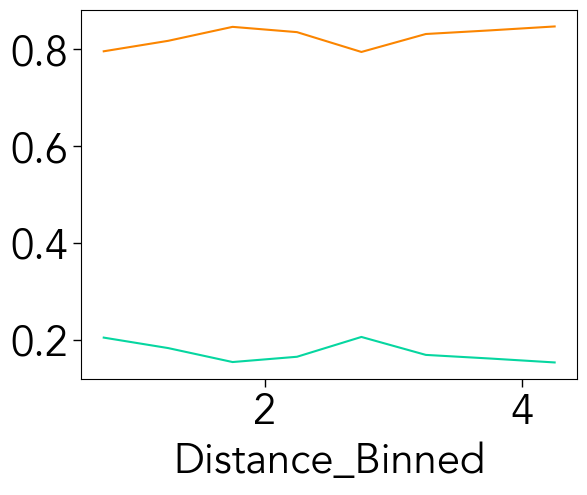

In [144]:
(df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"] / (df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"] + df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"])).plot(c=c2)
(df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"] / (df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"] + df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"])).plot(c=c1)


<Axes: xlabel='Distance_Binned'>

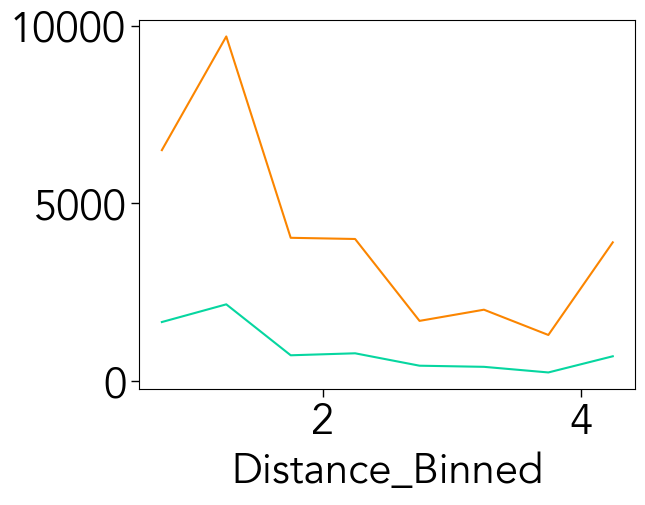

In [145]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"].plot(c=c2)
df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"].plot(c=c1)

<Axes: xlabel='Distance_Binned'>

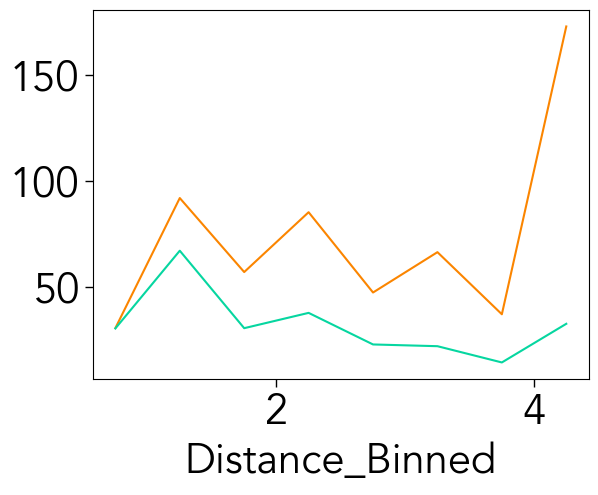

In [140]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["SST"].plot(c=c2)
df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["SST"].plot(c=c1)

<Axes: xlabel='Distance_Binned'>

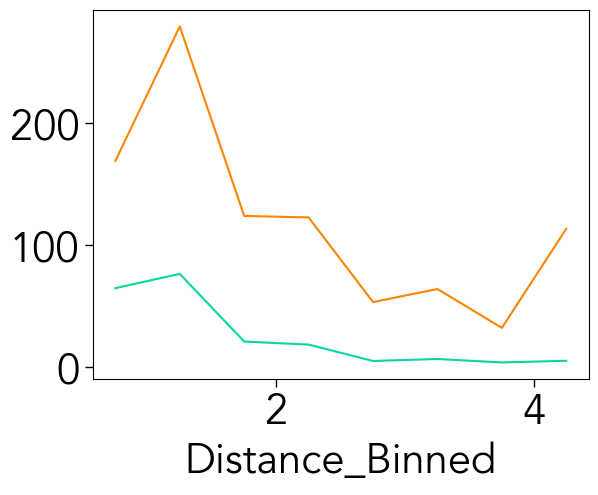

In [141]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["AT"].plot(c=c2)
df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["AT"].plot(c=c1)

<Axes: xlabel='Distance_Binned'>

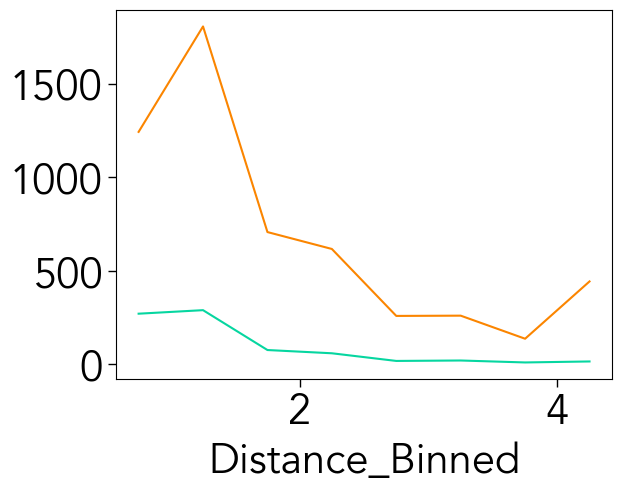

In [142]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["WS"].plot(c=c2)
df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["WS"].plot(c=c1)

In [123]:
import stats

ModuleNotFoundError: No module named 'stats'

In [108]:
from scipy.optimize import leastsq

In [109]:
leastsq?

Signature:
leastsq(
    func,
    x0,
    args=(),
    Dfun=None,
    full_output=False,
    col_deriv=False,
    ftol=1.49012e-08,
    xtol=1.49012e-08,
    gtol=0.0,
    maxfev=0,
    epsfcn=None,
    factor=100,
    diag=None,
)
Docstring:
Minimize the sum of squares of a set of equations.

::

    x = arg min(sum(func(y)**2,axis=0))
             y

Parameters
----------
func : callable
    Should take at least one (possibly length ``N`` vector) argument and
    returns ``M`` floating point numbers. It must not return NaNs or
    fitting might fail. ``M`` must be greater than or equal to ``N``.
x0 : ndarray
    The starting estimate for the minimization.
args : tuple, optional
    Any extra arguments to func are placed in this tuple.
Dfun : callable, optional
    A function or method to compute the Jacobian of func with derivatives
    across the rows. If this is None, the Jacobian will be estimated.
full_output : bool, optional
    If ``True``, return all optional outputs (not just

In [106]:
scipy.optimize.leastsq()

NameError: name 'scipy' is not defined

In [105]:
linregress?

Signature: linregress(x, y=None, alternative='two-sided')
Docstring:
Calculate a linear least-squares regression for two sets of measurements.

Parameters
----------
x, y : array_like
    Two sets of measurements.  Both arrays should have the same length N.  If
    only `x` is given (and ``y=None``), then it must be a two-dimensional
    array where one dimension has length 2.  The two sets of measurements
    are then found by splitting the array along the length-2 dimension. In
    the case where ``y=None`` and `x` is a 2xN array, ``linregress(x)`` is
    equivalent to ``linregress(x[0], x[1])``.

    .. deprecated:: 1.14.0
        Inference of the two sets of measurements from a single argument `x`
        is deprecated will result in an error in SciPy 1.16.0; the sets
        must be specified separately as `x` and `y`.
alternative : {'two-sided', 'less', 'greater'}, optional
    Defines the alternative hypothesis. Default is 'two-sided'.
    The following options are available:

 

In [274]:
ax[0].get_ylim()

(0.0, 1.0)

In [169]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").count()["Qsens"]

Distance_Binned
0.75    1196
1.25    1640
1.75     576
2.25     515
2.75     221
3.25     216
3.75     109
4.25     321
Name: Qsens, dtype: int64

In [171]:
df.Distance_Binned

0       2.75
1       1.25
2       2.25
3       1.25
4       1.25
        ... 
8433    2.25
8434    1.25
8435    4.25
8436    1.25
8437    0.75
Name: Distance_Binned, Length: 8438, dtype: float64

In [172]:
df.Distance

0       2.8
1       1.0
2       2.2
3       1.2
4       1.0
       ... 
8433    2.4
8434    1.2
8435    4.8
8436    1.4
8437    0.8
Name: Distance, Length: 8438, dtype: float64

In [174]:
np.unique(df.Distance_Binned)

array([0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.75, 4.25])

In [173]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").count()["Qsens"]

Distance_Binned
0.75    1196
1.25    1640
1.75     576
2.25     515
2.75     221
3.25     216
3.75     109
4.25     321
Name: Qsens, dtype: int64

In [179]:
ax[1].get_xlim()

(-0.5, 7.5)

(-0.1, 100.1, -0.495, 1.595)

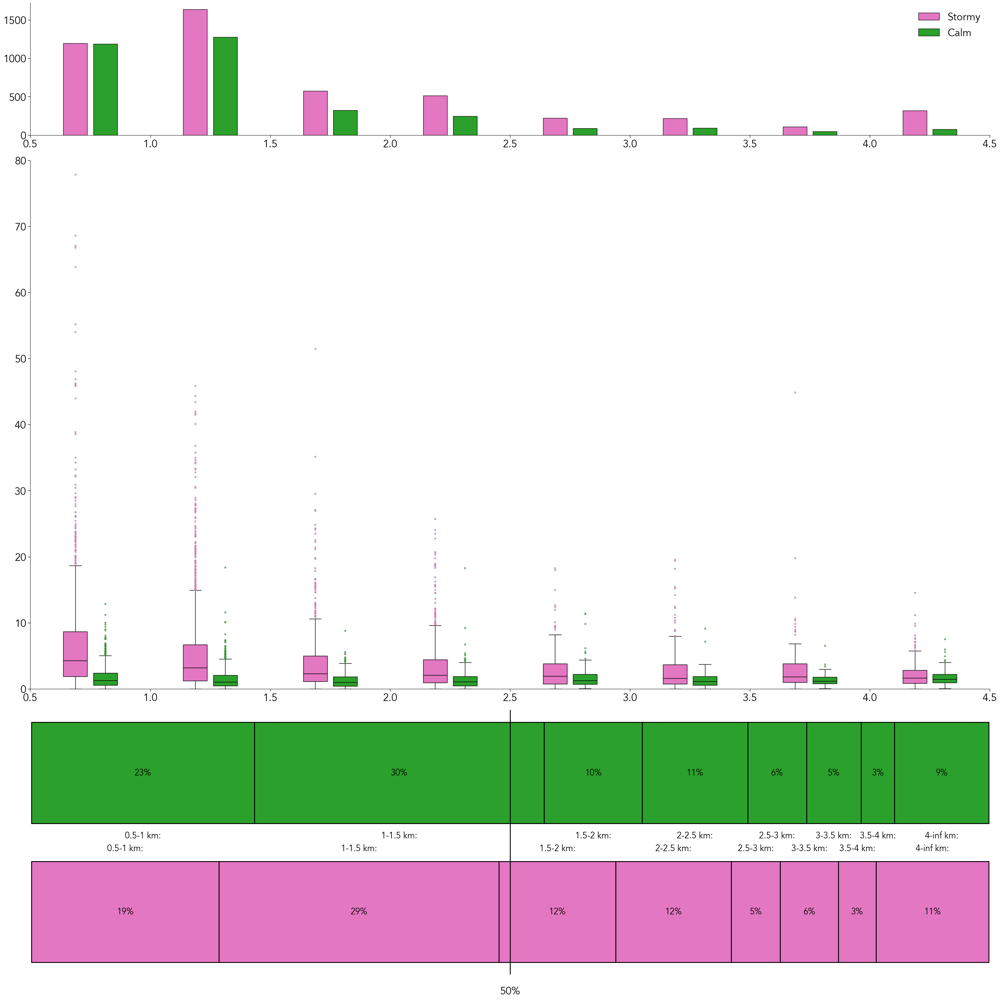

In [211]:
def plot_boxes(df, ax, ylim):
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=["C6","C2"], ax=ax, width=0.5,gap=0.2,saturation=1,native_scale=True,
                flierprops={"marker": "."},
                boxprops={"zorder": 2, "lw":1},
                medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=["C6","C2"], ax=ax, width=0.5,gap=0.2,fill=False,native_scale=True,
                flierprops={"marker": "."},
                whiskerprops={"color": "k","lw":1},
                capprops={"color": "k","lw":1},
                boxprops={"zorder": 2, "lw":1, "color":"k"},
                medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    ax.set(title="", xlabel="", ylabel="", ylim=ylim)

    return bp

# Create the grid specification
fig, ax = plt.subplots(3,1,figsize=(32, 32),constrained_layout=True, height_ratios=[1,4,2],sharex=False)

ax[0].bar(np.unique(df.Distance_Binned)-0.0625,df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").count()["Qsens"],color="C6",ec="k", zorder=2,ls='-', lw=1, width=0.1,label="Stormy")#, marker=".",mew=2,mec="r",mfc="r",ms=ms)
ax[0].bar(np.unique(df.Distance_Binned)+0.0625,df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").count()["Qsens"],color="C2",ec="k", zorder=2,ls='-', lw=1, width=0.1,label="Calm")#, marker=".",mew=2,mec="r",mfc="r",ms=ms)

bp = plot_boxes(df, ax[1], (0,80))
ax[1].spines['left'].set_bounds(0,80)

ax[0].legend(loc="upper right",frameon=False)

for axs in ax:
    axs.spines['top'].set_visible(False)
    axs.spines['right'].set_visible(False)
    axs.set(xlim=(0.5,4.5))

white_or_black("white")

axs = ax[2]

parts = (df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"]/df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"].sum()*100)
edges = np.insert(parts.cumsum(),0,0)

for i in range(len(parts)):
    axs.barh(y=0, left=edges[i], width=parts.iloc[i], color="C6", ec="k",lw=2)
    axs.text(edges[i] + parts.iloc[i]/2, +0.5, f"{bins[i]}-{bins[i+1]} km:", ha="center", va="center", fontsize="small")
    axs.text(edges[i] + parts.iloc[i]/2, 0, f"{int(parts.iloc[i])}%", ha="center", va="center", fontsize="small")


axs.text(50,-0.65,"50%",c="k",ha="center")
#axs.text(50,-0.575,"50%",c="w",ha="center")
axs.axvline(50,c="k",ls="-",lw=2)

parts = (df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"]/df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"].sum()*100)
edges = np.insert(parts.cumsum(),0,0)

for i in range(len(parts)):
    axs.barh(y=1.1, left=edges[i], width=parts.iloc[i], color="C2", ec="k",lw=2)
    axs.text(edges[i] + parts.iloc[i]/2, 0.6, f"{bins[i]}-{bins[i+1]} km:", ha="center", va="center", fontsize="small")
    axs.text(edges[i] + parts.iloc[i]/2, 1.1, f"{int(parts.iloc[i])}%", ha="center", va="center", fontsize="small")

axs.set(xlim=(-0.1,100.1))

axs.axis("off")

In [212]:
df.where(df["Calm"]==True).describe()

,Distance,SST,AT,WS,Qsens,SST gradient,AT gradient,WS gradient,Qsens gradient,Distance_Binned
count,3541.000000,3541.000000,3413.000000,3463.000000,3335.000000,3541.000000,3413.000000,3463.000000,3335.000000,3541.000000
mean,1.371025,0.077558,0.061117,0.229417,2.144937,0.047632,0.052930,0.206894,1.586724,1.392897
std,0.871356,0.129363,0.050567,0.143645,2.833052,0.058969,0.049238,0.155727,1.570713,0.789710
min,0.800000,0.000436,0.000000,0.000248,0.000635,0.000545,0.000000,0.000298,0.000794,0.750000
25%,0.800000,0.020089,0.020000,0.103597,0.577570,0.021318,0.016313,0.079460,0.506888,0.750000
50%,1.000000,0.035795,0.046500,0.217302,1.338567,0.031266,0.037500,0.172278,1.149617,1.250000
75%,1.600000,0.078968,0.090911,0.351996,2.695959,0.052502,0.075000,0.306327,2.154270,1.750000
max,13.000000,2.766892,0.200000,0.499931,38.125779,1.603795,0.250000,0.624914,18.388706,4.250000


In [216]:
df.where(df["Calm"]==True).iloc[df.where(df["Calm"]==True)["SST gradient"].argmin()]

Distance                0.8
SST                0.000436
AT                 0.051666
WS                 0.175275
Qsens              1.035141
SST gradient       0.000545
AT gradient        0.064583
WS gradient        0.219093
Qsens gradient     1.293926
Calm                   True
Distance_Binned        0.75
Drone                SD1022
Name: 2559, dtype: object

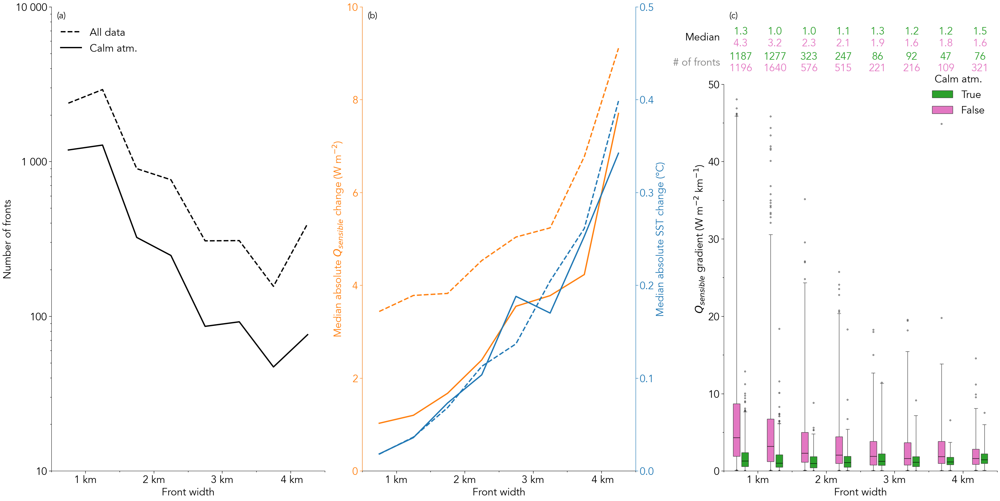

In [187]:
def plot_boxes(df, ax, ylim):
    
    bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=["C6","C2"], ax=ax, width=0.5,gap=0.2, saturation=1,whis=[1,99],

                flierprops={"marker": "."},
                boxprops={"zorder": 2, "lw":1},
                medianprops={"color": "k", "linewidth": 1}, zorder=2)
    
    # bp = sns.boxplot(data=df, y="Qsens gradient", x="Distance_Binned", hue="Calm", palette=["C6","C2"], ax=ax, width=0.5,gap=0.2,fill=False,
    #             flierprops={"marker": "."},
    #             whiskerprops={"color": "k","lw":1},
    #             capprops={"color": "k","lw":1},
    #             boxprops={"zorder": 2, "lw":1, "color":"k"},
    #             medianprops={"color": "k", "linewidth": 1}, zorder=2,legend=False)
    ax.set(title="", xlabel="", ylabel="", ylim=ylim)

    ax.legend(loc="upper right",bbox_to_anchor=(0.99,0.875), title="Calm atm.", reverse=True, frameon=False)

    

# Create the grid specification
fig,ax = plt.subplots(1,3,figsize=(32, 16),constrained_layout=True)

for axs in ax:
    axs.spines['top'].set_visible(False)
    axs.spines['right'].set_visible(False)


bx=ax[1].twinx()
bx.spines['top'].set_visible(False)
ms=0
df.drop(columns="Drone").groupby("Distance_Binned").count()["Qsens"].plot(ax=ax[0],color="k", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="r",mfc="r",ms=ms)
df_calm.groupby("Distance_Binned").count()["Qsens"].plot(ax=ax[0],color="k", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="r",mfc="r",ms=ms)
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").median()["Qsens"].plot(ax=ax[1],color="C1", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=ms)
df_calm.groupby("Distance_Binned").median()["Qsens"].plot(ax=ax[1],color="C1", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=ms)
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").median()["SST"].plot(ax=bx,color="C0", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=ms)
df_calm.groupby("Distance_Binned").median()["SST"].plot(ax=bx,color="C0", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=ms)

n=0

plot_boxes(df, ax[2], (0,50-n))
ax[2].spines['left'].set_bounds(0,50-n)



medians1 = df_calm.groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
medians2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
ns1 = df_calm.groupby("Distance_Binned")["Qsens gradient"].count().values
ns2 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens gradient"].count().values

for m1,m2,n1,n2,x in zip(medians1,medians2,ns1,ns2,np.arange(0,22,1)):
    ax[2].text(x,58.75-n-2,m1,ha="center",va="center",fontweight="bold",c="C2",bbox=dict(boxstyle="round,pad=0.3", edgecolor="w", facecolor="w"))
    ax[2].text(x,57.25-n-2,m2,ha="center",va="center",fontweight="bold",c="C6",bbox=dict(boxstyle="round,pad=0.3", edgecolor="w", facecolor="w"))
    ax[2].text(x,55.5-n-2,n1,ha="center",va="center",c="C2",bbox=dict(boxstyle="round,pad=0.3", edgecolor="w", facecolor="w"))
    ax[2].text(x,54.0-n-2,n2,ha="center",va="center",c="C6",bbox=dict(boxstyle="round,pad=0.3", edgecolor="w", facecolor="w"))

ax[2].text(-0.6,58-n-2,"Median",ha="right",va="center",fontweight="bold")
ax[2].text(-0.6,54.75-n-2,"# of fronts",ha="right",va="center",c="grey")

ax[2].set_xlim(-0.5,7.5)
ax[2].set_xticks(np.arange(0.5,8.5,2),labels=[f"{int(j)} km" for j in np.arange(1,4.5,1)])
ax[2].set_xticks(np.arange(-0.5,8,1),minor=True)
#ax[2].grid(which="major")

bx.set(ylim=(0,0.5),ylabel="Median absolute SST change (°C)")

line1 = Line2D([], [], linestyle='--',lw=3, color='black', label='All data')
line2 = Line2D([], [], linestyle='-',lw=3, color='black', label='Calm atm.')

# Add the custom legend handles
ax[0].legend(handles=[line1, line2],loc="upper left",frameon=False,bbox_to_anchor=(0,0.975),)

for axs,c,s in zip([ax[1],bx],["C1","C0"],["left","right"]): 
    bx.spines[s].set_color(c)
    bx.spines[s].set_linewidth(1)
    bx.spines[s].set_zorder(3)
    axs.tick_params(axis='y', colors=c)
    axs.yaxis.set_tick_params(labelcolor=c)
    axs.yaxis.label.set_color(c)
    
# Define parameters for plotting
parameters = [
    (ax[0], "log", "Number of fronts", [1e1,1e4],[1e1,1e2,1e3,1e4],["10","100","1 000","10 000"]),
    (ax[1], "linear", "Median absolute $Q_{sensible}$ change (W m$^{-2}$)", [0,10],np.arange(0,10.1,2),np.arange(0,10.1,2).astype(int)),
    (ax[2], "linear", r"$Q_{sensible}$ gradient (W m$^{-2}$ km$^{-1}$)", [0,60-n],np.arange(0,51-n,10),np.arange(0,51-n,10))
]

# Set common axis properties
for i,(axs, yscale, ylabel, ylim, yticks, ylabels) in enumerate(parameters):
    axs.set(xlabel="Front width", yscale=yscale, ylabel=ylabel,ylim=ylim)
    axs.set_yticks(yticks,labels=ylabels)
    if i < 2:
        axs.set_xticks(np.arange(1,4.5,1), labels=["1 km", "2 km", "3 km", " 4 km"])
        axs.set_xticks(np.arange(0.5,4.6,0.5),minor=True)
    #axs.grid(which="minor", zorder=1)
    #axs.grid(which="major", zorder=1)

for axs,l,x,y in zip(ax,["(a)","(b)","(c)"],[0.75,0.75,0],[1e4,10,60-n]):
    #axs.text(x,y,l,ha="center",va="bottom",fontweight="bold")
    axs.text(0.02,0.99,l,ha="left",va="top",fontsize="small",transform=axs.transAxes)

ax[2].set_yticks(np.arange(0,51-n,5),minor=True)

white_or_black("white")

# plt.tight_layout()
# plt.savefig("../figures/front-heat-flux-boxplots.png")

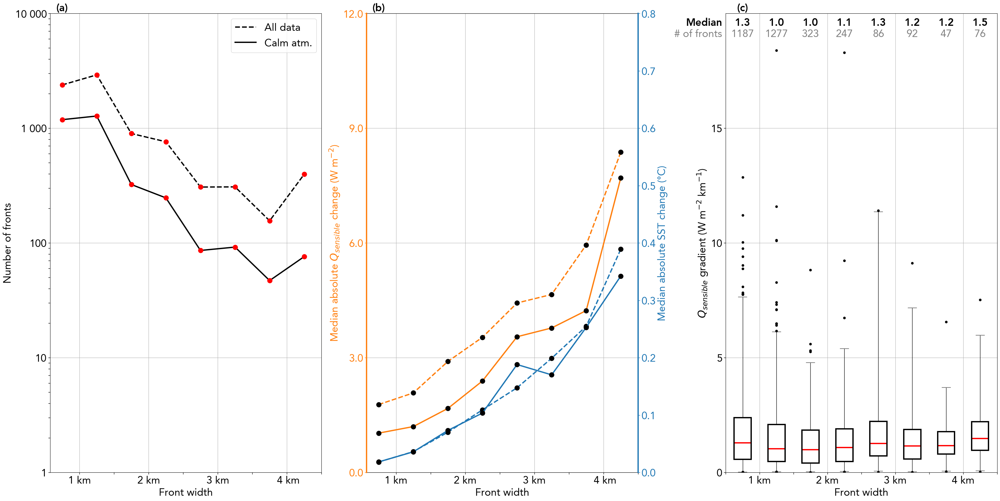

In [233]:
def plot_boxes(df, ax, ylim):
    sns.boxplot(data=df_calm, y="Qsens gradient", x="Distance_Binned", palette=["pink","lightblue"], ax=ax, width=0.5, whis=[1, 99],
                flierprops={"marker": "o","mec":"k","mfc":"k"},
                boxprops={"zorder": 2, "edgecolor":"k","facecolor":"None","lw":3},
                whiskerprops={"zorder": 2, "c":"k", "lw":1},
                medianprops={"color": "r", "linewidth": 3,"zorder":1})
    ax.set(title="", xlabel="", ylabel="", ylim=ylim)

# Create the grid specification
fig,ax = plt.subplots(1,3,figsize=(32, 16),constrained_layout=True)

bx=ax[1].twinx()
df.drop(columns="Drone").groupby("Distance_Binned").count()["Qsens"].plot(ax=ax[0],color="k", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="r",mfc="r",ms=20)
df_calm.groupby("Distance_Binned").count()["Qsens"].plot(ax=ax[0],color="k", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="r",mfc="r",ms=20)
df.drop(columns="Drone").groupby("Distance_Binned").median()["Qsens"].plot(ax=ax[1],color="C1", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=20)
df_calm.groupby("Distance_Binned").median()["Qsens"].plot(ax=ax[1],color="C1", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=20)
df.drop(columns="Drone").groupby("Distance_Binned").median()["SST"].plot(ax=bx,color="C0", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=20)
df_calm.groupby("Distance_Binned").median()["SST"].plot(ax=bx,color="C0", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=20)

plot_boxes(df, ax[2], (0,20))

medians = df_calm.groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
ns = df_calm.groupby("Distance_Binned")["Qsens gradient"].count().values

for m,n,x in zip(medians,ns,np.arange(0,22,1)):
    ax[2].text(x,19.6,m,ha="center",va="center",fontweight="bold")
    ax[2].text(x,19.1,n,ha="center",va="center",c="grey")

ax[2].text(-0.6,19.6,"Median",ha="right",va="center",fontweight="bold")
ax[2].text(-0.6,19.1,"# of fronts",ha="right",va="center",c="grey")

ax[2].set_xlim(-0.5,7.5)
ax[2].set_xticks(np.arange(0.5,8.5,2),labels=[f"{int(j)} km" for j in np.arange(1,4.5,1)])
ax[2].set_xticks(np.arange(-0.5,8,1),minor=True)
ax[2].grid(which="major")

bx.set(ylim=(0,0.8),ylabel="Median absolute SST change (°C)")

line1 = Line2D([], [], linestyle='--',lw=3, color='black', label='All data')
line2 = Line2D([], [], linestyle='-',lw=3, color='black', label='Calm atm.')

# Add the custom legend handles
ax[0].legend(handles=[line1, line2])


for axs,c,s in zip([ax[1],bx],["C1","C0"],["left","right"]): 
    bx.spines[s].set_color(c)
    bx.spines[s].set_linewidth(3)
    bx.spines[s].set_zorder(3)
    axs.tick_params(axis='y', colors=c)
    axs.yaxis.set_tick_params(labelcolor=c)
    axs.yaxis.label.set_color(c)
    
# Define parameters for plotting
parameters = [
    (ax[0], "log", "Number of fronts", [1e0,1e4],[1e0,1e1,1e2,1e3,1e4],["1","10","100","1 000","10 000"]),
    (ax[1], "linear", "Median absolute $Q_{sensible}$ change (W m$^{-2}$)", [0,12],np.arange(0,12.1,3),np.arange(0,12.1,3).round(1)),
    (ax[2], "linear", r"$Q_{sensible}$ gradient (W m$^{-2}$ km$^{-1}$)", [0,20],np.arange(0,16,5),np.arange(0,16,5))

]


# Set common axis properties
for i,(axs, yscale, ylabel, ylim, yticks, ylabels) in enumerate(parameters):
    axs.set(xlabel="Front width", yscale=yscale, ylabel=ylabel,ylim=ylim)
    axs.set_yticks(yticks,labels=ylabels)
    if i < 2:
        axs.set_xticks(np.arange(1,4.5,1), labels=["1 km", "2 km", "3 km", " 4 km"])
        axs.set_xticks(np.arange(1,4.6,0.5),minor=True)
    #axs.grid(which="minor", zorder=1)
    axs.grid(which="major", zorder=1)

for axs,l,x,y in zip(ax,["(a)","(b)","(c)"],[0.75,0.75,0],[1e4,12,20]):
    axs.text(x,y,l,ha="center",va="bottom",fontweight="bold")

# plt.tight_layout()
# plt.savefig("../figures/front-heat-flux-boxplots.png")

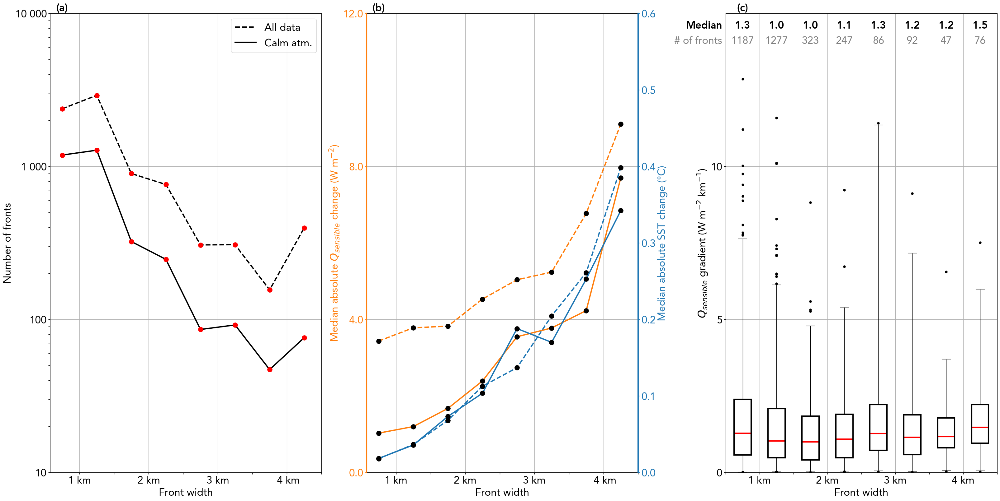

In [13]:
def plot_boxes(df, ax, ylim):
    sns.boxplot(data=df_calm, y="Qsens gradient", x="Distance_Binned", palette=["pink","lightblue"], ax=ax, width=0.5, whis=[1, 99],
                flierprops={"marker": "o","mec":"k","mfc":"k"},
                boxprops={"zorder": 2, "edgecolor":"k","facecolor":"None","lw":3},
                whiskerprops={"zorder": 2, "c":"k", "lw":1},
                medianprops={"color": "r", "linewidth": 3,"zorder":1})
    ax.set(title="", xlabel="", ylabel="", ylim=ylim)

# Create the grid specification
fig,ax = plt.subplots(1,3,figsize=(32, 16),constrained_layout=True)

bx=ax[1].twinx()
df.drop(columns="Drone").groupby("Distance_Binned").count()["Qsens"].plot(ax=ax[0],color="k", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="r",mfc="r",ms=20)
df_calm.groupby("Distance_Binned").count()["Qsens"].plot(ax=ax[0],color="k", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="r",mfc="r",ms=20)
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").median()["Qsens"].plot(ax=ax[1],color="C1", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=20)
df_calm.groupby("Distance_Binned").median()["Qsens"].plot(ax=ax[1],color="C1", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=20)
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").median()["SST"].plot(ax=bx,color="C0", zorder=2,ls='--', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=20)
df_calm.groupby("Distance_Binned").median()["SST"].plot(ax=bx,color="C0", zorder=2,ls='-', lw=3, marker=".",mew=2,mec="k",mfc="k",ms=20)

plot_boxes(df, ax[2], (0,20))

medians = df_calm.groupby("Distance_Binned")["Qsens gradient"].median().values.round(1)
ns = df_calm.groupby("Distance_Binned")["Qsens gradient"].count().values

for m,n,x in zip(medians,ns,np.arange(0,22,1)):
    ax[2].text(x,19.6-5,m,ha="center",va="center",fontweight="bold")
    ax[2].text(x,19.1-5,n,ha="center",va="center",c="grey")

ax[2].text(-0.6,19.6-5,"Median",ha="right",va="center",fontweight="bold")
ax[2].text(-0.6,19.1-5,"# of fronts",ha="right",va="center",c="grey")

ax[2].set_xlim(-0.5,7.5)
ax[2].set_xticks(np.arange(0.5,8.5,2),labels=[f"{int(j)} km" for j in np.arange(1,4.5,1)])
ax[2].set_xticks(np.arange(-0.5,8,1),minor=True)
ax[2].grid(which="major")

bx.set(ylim=(0,0.6),ylabel="Median absolute SST change (°C)")

line1 = Line2D([], [], linestyle='--',lw=3, color='black', label='All data')
line2 = Line2D([], [], linestyle='-',lw=3, color='black', label='Calm atm.')

# Add the custom legend handles
ax[0].legend(handles=[line1, line2])


for axs,c,s in zip([ax[1],bx],["C1","C0"],["left","right"]): 
    bx.spines[s].set_color(c)
    bx.spines[s].set_linewidth(3)
    bx.spines[s].set_zorder(3)
    axs.tick_params(axis='y', colors=c)
    axs.yaxis.set_tick_params(labelcolor=c)
    axs.yaxis.label.set_color(c)
    
# Define parameters for plotting
parameters = [
    (ax[0], "log", "Number of fronts", [1e1,1e4],[1e1,1e2,1e3,1e4],["10","100","1 000","10 000"]),
    (ax[1], "linear", "Median absolute $Q_{sensible}$ change (W m$^{-2}$)", [0,12],np.arange(0,12.1,4),np.arange(0,12.1,4).round(1)),
    (ax[2], "linear", r"$Q_{sensible}$ gradient (W m$^{-2}$ km$^{-1}$)", [0,15],np.arange(0,15,5),np.arange(0,15,5))

]


# Set common axis properties
for i,(axs, yscale, ylabel, ylim, yticks, ylabels) in enumerate(parameters):
    axs.set(xlabel="Front width", yscale=yscale, ylabel=ylabel,ylim=ylim)
    axs.set_yticks(yticks,labels=ylabels)
    if i < 2:
        axs.set_xticks(np.arange(1,4.5,1), labels=["1 km", "2 km", "3 km", " 4 km"])
        axs.set_xticks(np.arange(1,4.6,0.5),minor=True)
    #axs.grid(which="minor", zorder=1)
    axs.grid(which="major", zorder=1)

for axs,l,x,y in zip(ax,["(a)","(b)","(c)"],[0.75,0.75,0],[1e4,12,15]):
    axs.text(x,y,l,ha="center",va="bottom",fontweight="bold")

# plt.tight_layout()
# plt.savefig("../figures/front-heat-flux-boxplots.png")

In [ ]:
ax.errorbar()

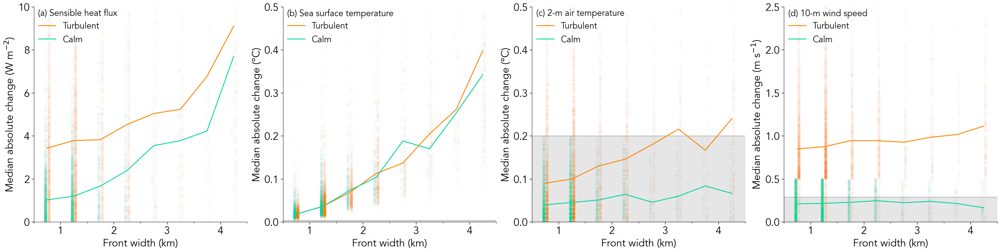

In [322]:
fig, axs = plt.subplots(1,4,figsize=(32,8),constrained_layout=True)

var = ["Qsens","SST","AT","WS"]

for ax,v,t,l,u in zip(axs,var,[r"Sensible heat flux","Sea surface temperature","Air temperature","Wind speed"],[r"Q$_{sensible}$","SST","AT","WS"],["(W m$^{-2}$)","(°C)","(°C)","(m s$^{-1}$)"]):

    m1 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").median()[v]# .plot(ax=ax,color=c2, zorder=2,lw=3,label="Turbulent")#, marker=".",mew=2,mec="k",mfc="k",ms=10)
    m2 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").median()[v]# .plot(ax=ax,color=c1, zorder=2,lw=3,label="Calm")#, marker=".",mew=2,mec="k",mfc="k",ms=10)
    y1 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").std()[v]
    y2 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").std()[v]
    n1 = df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").count()[v]
    n2 = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").count()[v]

    
    ax.plot(np.arange(0.75,4.5,0.5),m1,c=c2,lw=2,label="Turbulent",zorder=3)
    ax.plot(np.arange(0.75,4.5,0.5),m2,c=c1,lw=2,label="Calm",zorder=3)
    
    # Plot with offsets using ax.scatter
    ax.scatter(
        x=df.loc[df["Calm"] == False, "Distance_Binned"] + 0.03, 
        y=df.loc[df["Calm"] == False, v], 
        c=c2, 
        zorder=2, 
        alpha=0.01)
    
    ax.scatter(
        x=df.loc[df["Calm"] == True, "Distance_Binned"] - 0.03, 
        y=df.loc[df["Calm"] == True, v], 
        c=c1, 
        zorder=2, 
        alpha=0.01)
    
    ax.set(xlabel="Front width (km)",ylabel="Median absolute change " + u, xlim=(0.5,4.5), xticks=np.arange(1,5,1))
    ax.set_xticks(np.arange(0.5,5,0.5),minor=True)
    ax.legend(fontsize="small",frameon=False,loc="upper left",bbox_to_anchor=(-0.015,0.9675))
    #ax.grid(zorder=1)

for ax,ylim in zip(axs,[[0,10],[0,0.5],[0,0.5],[0,2.5]]):
    ax.set_ylim(ylim)

for ax,l,n in zip(axs,["(a)","(b)","(c)","(d)"],[r"Sensible heat flux","Sea surface temperature","2-m air temperature","10-m wind speed"]):
    ax.text(0.02, 0.99, f"{l} {n}", ha="left", va="top", fontsize="small", transform=ax.transAxes)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

axs[3].set_yticks(np.arange(0,2.6,.5))

for ax,y in zip(axs[1:],[0.004,0.2,12*0.012*2]):
    ax.fill_between([0.5,4.5],[y,y],0,fc="0.9",lw=1,ec="k",ls=":", zorder=1)

In [346]:
from scipy.stats import linregress

In [359]:
# Initialize lists to store results
results = []

# Loop through variables and calculate regression statistics
variables = ["Qsens", "SST", "AT", "WS"][::-1]
names = [r"Sensible heat flux", "Sea surface temperature", "Air temperature", "Wind speed"][::-1]

for v, n in zip(variables, names):
    # Linear regression for calm conditions
    k_c, m_c, r_c, p_c, _ = linregress(
        np.arange(0.75, 4.3, 0.5),
        df.drop(columns="Drone")
          .where(df["Calm"] == True)
          .dropna()
          .groupby("Distance_Binned")
          .median()[v]
    )
    
    # Linear regression for turbulent conditions
    k, m, r, p, _ = linregress(
        np.arange(0.75, 4.3, 0.5),
        df.drop(columns="Drone")
          .where(df["Calm"] == False)
          .dropna()
          .groupby("Distance_Binned")
          .median()[v]
    )
    
    # Append results to the list
    results.append({
        "Variable": n,
        "Slope": f"{k_c:.2f} ({k:.2f})",
        "Intercept": f"{m_c:.2f} ({m:.2f})",
        "R²": f"{r_c**2:.2f} ({r:.2f})",
        "p-value": f"{p_c:.2f} ({p:.2f})"})

# Create a DataFrame
df_results = pd.DataFrame(results)

df_results

,Variable,Slope,Intercept,R²,p-value
0,Wind speed,-0.01 (0.06),0.24 (0.80),0.22 (0.92),0.24 (0.00)
1,Air temperature,0.01 (0.04),0.04 (0.06),0.60 (0.93),0.02 (0.00)
2,Sea surface temperature,0.09 (0.10),-0.07 (-0.10),0.93 (0.96),0.00 (0.00)
3,Sensible heat flux,1.65 (1.41),-0.94 (1.68),0.85 (0.91),0.00 (0.00)


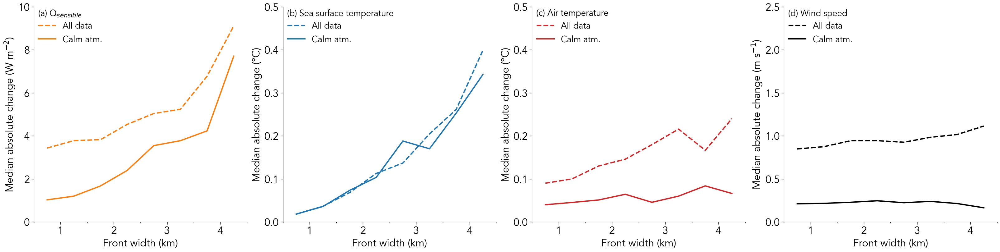

In [ ]:
# variables = ["Qsens", "SST", "AT", "WS"]
# cs = ["C1","C0","C3","k"]
# names = [r"Q$_{sensible}$","Sea surface temperature","Air temperature","Wind speed"]
# units = ["(W m$^{-2}$)","(°C)","(°C)","(m s$^{-1}$)"]

# for ax,v,c,n,u in zip(axes[1],variables,cs,names,units):

#     k_c,m_c,r_c,p_c,_ = linregress(np.arange(0.75,4.3,0.5),df_calm.dropna().groupby("Distance_Binned").median()[v])
#     k,m,r,p,_ = linregress(np.arange(0.75,4.3,0.5),df.drop(columns="Drone").dropna().groupby("Distance_Binned").median()[v])

#     # Determine the sign of m_c and format accordingly
#     if m_c >= 0:
#         m_c_str = f"+ {m_c:.2f}"
#     else:
#         m_c_str = f"- {abs(m_c):.2f}"

#         # Determine the sign of m_c and format accordingly
#     if m >= 0:
#         m_str = f"+ {m:.2f}"
#     else:
#         m_str = f"- {abs(m):.2f}"

#     # Plot with label including the regression equation
#     ax.plot(np.arange(1, 100, 1), np.arange(1, 100, 1) * k + m, c=c, ls="--", lw=3, label=rf"y = {k:.2f}x {m_str}", zorder=2)
#     ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="", lw=3, label=r"R$^2$="+f"{(r**2).round(3)}", zorder=2)
#     ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="", lw=3, label=f"p={p.round(3)}", zorder=2)
#     ax.plot(np.arange(1, 100, 1), np.arange(1, 100, 1) * k_c + m_c, c=c, ls="-", lw=3, label=rf"y = {k_c:.2f}x {m_c_str}", zorder=2)
#     ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="", lw=3, label=r"R$^2$="+f"{(r_c**2).round(3)}", zorder=2)
#     ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="", lw=3, label=f"p={p_c.round(3)}", zorder=2)
#     ax.set(xlabel="Front width (km)", ylabel="Extrapolated change " + u,xlim=(0,100))
#     #ax.set_title(n,loc="left",y=0.925,x=0.02)
#     ax.legend(fontsize="small",loc="upper left",reverse=False,ncol=2)
#     ax.grid(zorder=1)

# for axs,l,y in zip(axes[1],["(e)","(f)","(g)","(h)"],[10,1,1,1]):
#     axs.text(0.125*100/4.5,axs.get_ylim()[1],l,ha="center",va="bottom",fontweight="bold")

In [95]:
12*0.012*2

0.28800000000000003

(0.0, 5.0)

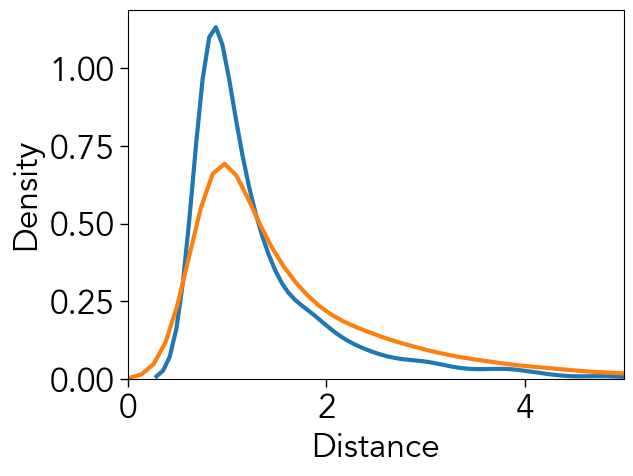

In [101]:
sns.kdeplot(df.where(df["Calm"]==True)["Distance"])
sns.kdeplot(df.where(df["Calm"]==False)["Distance"])
plt.xlim(0,5)

NameError: name 'linregress' is not defined

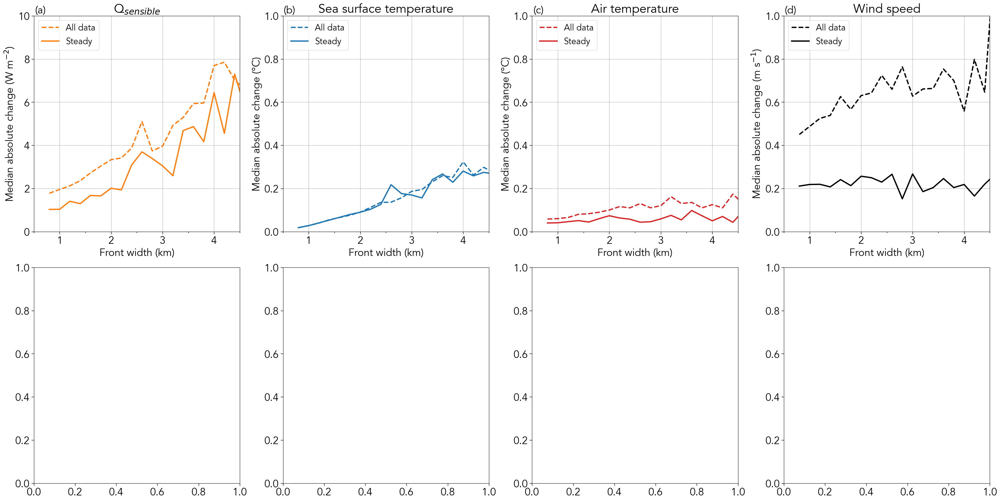

In [345]:
fig, axes = plt.subplots(2,4,figsize=(32,16),constrained_layout=True)

var = ["Qsens","SST","AT","WS"]

for axs,v,c,t,l,u in zip(axes[0],var,["C1","C0","C3","k"],[r"Q$_{sensible}$","Sea surface temperature","Air temperature","Wind speed"],[r"Q$_{sensible}$","SST","AT","WS"],["(W m$^{-2}$)","(°C)","(°C)","(m s$^{-1}$)"]):

    df.drop(columns="Drone").groupby("Distance").median()[v].plot(ax=axs,color=c, zorder=2,ls='--', lw=3,label="All data")#, marker=".",mew=2,mec="k",mfc="k",ms=10)
    df_calm.groupby("Distance").median()[v].plot(ax=axs,color=c, zorder=2,ls='-', lw=3,label="Steady")#, marker=".",mew=2,mec="k",mfc="k",ms=10)
    axs.set(xlabel="Front width (km)",ylabel="Median absolute change " + u)
    axs.set_title(t)
    axs.set_xlim(0.5,4.5)
    axs.set_xticks(np.arange(1,5,1))
    axs.set_xticks(np.arange(0.5,5,0.5),minor=True)
    axs.legend(fontsize="small",loc="upper left")
    axs.grid(zorder=1)

for axs in axes[0][1:]:
    axs.set_ylim(0,1)
axes[0][0].set_ylim(0,10)

for axs,l,y in zip(axes[0],["(a)","(b)","(c)","(d)"],[10,1,1,1]):
    axs.text(0.625,y,l,ha="center",va="bottom",fontweight="bold")

variables = ["Qsens", "SST", "AT", "WS"]
cs = ["C1","C0","C3","k"]
names = [r"Q$_{sensible}$","Sea surface temperature","Air temperature","Wind speed"]
units = ["(W m$^{-2}$)","(°C)","(°C)","(m s$^{-1}$)"]

for ax,v,c,n,u in zip(axes[1],variables,cs,names,units):

    k_c,m_c,r_c,p_c,_ = linregress(df_calm.dropna()["Distance"],df_calm.dropna()[v])
    k,m,r,p,_ = linregress(df.where(df["Calm"]==False).dropna()["Distance"],df.drop(columns="Drone").where(df["Calm"]==False).dropna()[v])

    # Determine the sign of m_c and format accordingly
    if m_c >= 0:
        m_c_str = f"+ {m_c:.2f}"
    else:
        m_c_str = f"- {abs(m_c):.2f}"

        # Determine the sign of m_c and format accordingly
    if m >= 0:
        m_str = f"+ {m:.2f}"
    else:
        m_str = f"- {abs(m):.2f}"

    # Plot with label including the regression equation
    ax.plot(np.arange(1, 100, 1), np.arange(1, 100, 1) * k + m, c=c, ls="--", lw=3, label=rf"y = {k:.2f}x {m_str}", zorder=2)
    ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="", lw=3, label=r"R$^2$="+f"{(r**2).round(3)}", zorder=2)
    ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="", lw=3, label=f"p={p.round(3)}", zorder=2)
    ax.plot(np.arange(1, 100, 1), np.arange(1, 100, 1) * k_c + m_c, c=c, ls="-", lw=3, label=rf"y = {k_c:.2f}x {m_c_str}", zorder=2)
    ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="", lw=3, label=r"R$^2$="+f"{(r_c**2).round(3)}", zorder=2)
    ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="", lw=3, label=f"p={p_c.round(3)}", zorder=2)
    ax.set(xlabel="Front width (km)", ylabel="Extrapolated change " + u,xlim=(0,100))
    #ax.set_title(n,loc="left",y=0.925,x=0.02)
    ax.legend(fontsize="small",loc="upper left",reverse=False,ncol=2)
    ax.grid(zorder=1)

for axs,l,y in zip(axes[1],["(e)","(f)","(g)","(h)"],[10,1,1,1]):
    axs.text(0.125*100/4.5,axs.get_ylim()[1],l,ha="center",va="bottom",fontweight="bold")


In [48]:
mean = np.mean(df.drop(columns="Drone").groupby("Distance").median()["Qsens"] - df_calm.groupby("Distance").median()["Qsens"]).round(2)
std = np.std(df.drop(columns="Drone").groupby("Distance").median()["Qsens"] - df_calm.groupby("Distance").median()["Qsens"]).round(2)

print()

1.26

In [47]:
np.std(df.drop(columns="Drone").groupby("Distance").median()["Qsens"] - df_calm.groupby("Distance").median()["Qsens"])

0.5499888909560426

In [15]:
from scipy.stats import linregress

In [22]:
print("Calm atmosphere")
print("SST: ",(linregress(df_calm.dropna()["SST"],df_calm.dropna()["Qsens"]).rvalue**2).round(2))
print("AT: ",(linregress(df_calm.dropna()["AT"],df_calm.dropna()["Qsens"]).rvalue**2).round(2))
print("WS: ",(linregress(df_calm.dropna()["WS"],df_calm.dropna()["Qsens"]).rvalue**2).round(2))
print("All data")
print("SST: ",(linregress(df.dropna()["SST"],df.dropna()["Qsens"]).rvalue**2).round(2))
print("AT: ",(linregress(df.dropna()["AT"],df.dropna()["Qsens"]).rvalue**2).round(2))
print("WS: ",(linregress(df.dropna()["WS"],df.dropna()["Qsens"]).rvalue**2).round(2))

Calm atmosphere
SST:  0.58
AT:  0.08
WS:  0.01
All data
SST:  0.11
AT:  0.38
WS:  0.19


In [52]:
start20

array([    0,    38,   118, ..., 37819, 37838, 37878])

In [53]:
end20

array([   14,    43,   129, ..., 37827, 37847, 37885])

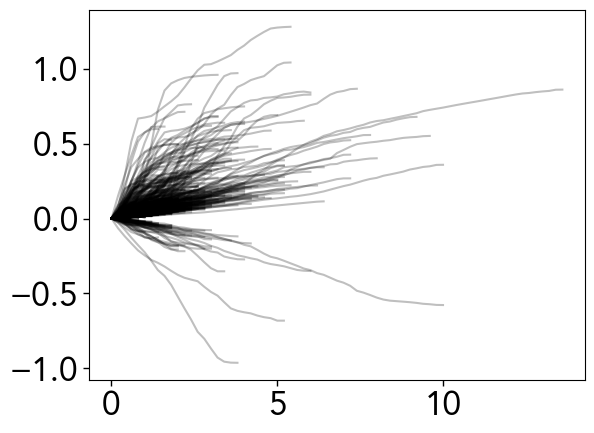

In [67]:
for i in range(1000):
    plt.plot(ds20.isel(distance=slice(start20[i],end20[i]+1))["distance"]-ds20.isel(distance=start20[i])["distance"].values,ds20.isel(distance=slice(start20[i],end20[i]+1))["sst"]-ds20.isel(distance=start20[i])["sst"].values,c="k",alpha=0.25)


In [68]:
print(df_calm.groupby("Distance").median()["Qsens"].round(2))
print(df_calm.groupby("Distance").median()["SST"].round(2))


Distance
0.75    1.07
1.25    1.38
1.75    1.86
2.25    3.20
2.75    3.19
3.25    4.74
3.75    4.56
4.25    8.13
Name: Qsens, dtype: float64
Distance
0.75    0.02
1.25    0.06
1.75    0.09
2.25    0.14
2.75    0.17
3.25    0.26
3.75    0.26
4.25    0.40
Name: SST, dtype: float64


In [81]:
np.nanmedian(ds20.where(np.abs(ds20["sst_grad"])<0.0125)["sens_grad"])

0.025645284982134253

In [82]:
np.nanmedian(ds22.where(np.abs(ds22["sst_grad"])<0.0125)["sens_grad"])

0.1003799128268773

In [83]:
np.nanmedian(ds23.where(np.abs(ds23["sst_grad"])<0.0125)["sens_grad"])

0.12321487898400818

In [12]:
df_calm.dropna().groupby("Distance").median()["Qsens"]

Distance
0.75    1.074615
1.25    1.380582
1.75    1.864244
2.25    3.203419
2.75    3.193483
3.25    4.738138
3.75    4.555715
4.25    8.128245
Name: Qsens, dtype: float64

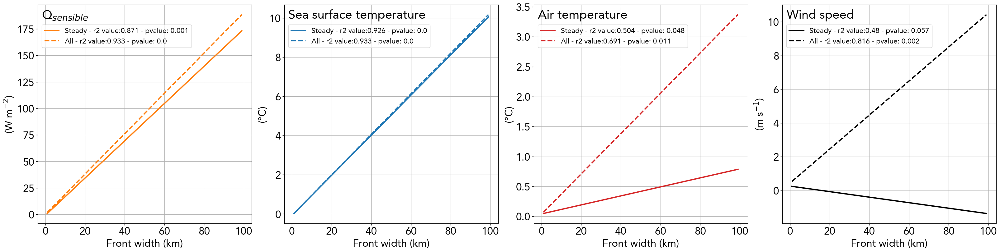

In [57]:
fig, axes = plt.subplots(1,4,figsize=(32,8),constrained_layout=True)

variables = ["Qsens", "SST", "AT", "WS"]
cs = ["C1","C0","C3","k"]
names = [r"Q$_{sensible}$","Sea surface temperature","Air temperature","Wind speed"]
units = ["(W m$^{-2}$)","(°C)","(°C)","(m s$^{-1}$)"]

for ax,v,c,n,u in zip(axes,variables,cs,names,units):

    k_c,m_c,r_c,p_c,_ = linregress(np.arange(0.75,4.3,0.5),df_calm.dropna().groupby("Distance").median()[v])
    k,m,r,p,_ = linregress(np.arange(0.75,4.3,0.5),df.drop(columns="Drone").dropna().groupby("Distance").median()[v])

    ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k_c + m_c, c=c, ls="-", lw=3, label=f"Steady - r2 value:{(r_c**2).round(3)} - pvalue: {p_c.round(3)}", zorder=2)
    ax.plot(np.arange(1,100,1),np.arange(1,100,1) * k + m, c=c, ls="--", lw=3, label=f"All - r2 value:{(r**2).round(3)} - pvalue: {p.round(3)}",zorder=2)
    ax.set(xlabel="Front width (km)", ylabel=u)
    ax.set_title(n,loc="left",y=0.925,x=0.02)
    ax.legend(fontsize="x-small",loc="upper left",bbox_to_anchor=(0.0025,0.925))
    ax.grid(zorder=1)

In [58]:
linregress(np.arange(0.75,4.3,0.5),df_calm.dropna().groupby("Distance").median()["Qsens"])

LinregressResult(slope=1.7586386541224157, intercept=-0.8792914825762495, rvalue=0.9331029654885653, pvalue=0.0007113970274420656, stderr=0.2766956594378757, intercept_stderr=0.7609130634541582)

In [21]:
linregress(np.arange(0.75,4.3,0.5),df.drop(columns="Drone").dropna().groupby("Distance").median()["Qsens"])

LinregressResult(slope=1.9037137593721591, intercept=0.01318962275416613, rvalue=0.9659053593605763, pvalue=9.656645233433352e-05, stderr=0.20831272967958256, intercept_stderr=0.5728600066188521)

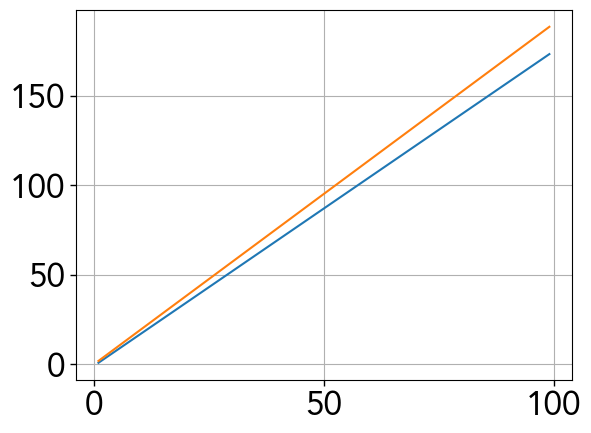

In [32]:
plt.plot(np.arange(1,100,1),np.arange(1,100,1) * 1.7586386541224157 - 0.8792914825762495)
plt.plot(np.arange(1,100,1),np.arange(1,100,1) * 1.9037137593721591 + 0.01318962275416613)
plt.grid()

In [23]:
linregress(np.arange(0.75,4.3,0.5),df_calm.dropna().groupby("Distance").median()["SST"])

LinregressResult(slope=0.10231522614022148, intercept=-0.07802646176998582, rvalue=0.962088314549147, pvalue=0.00013238173253219586, stderr=0.011841194788934008, intercept_stderr=0.03256328566956852)

In [24]:
linregress(np.arange(0.75,4.3,0.5),df.drop(columns="Drone").dropna().groupby("Distance").median()["SST"])

LinregressResult(slope=0.10352060887913973, intercept=-0.08235757375284847, rvalue=0.9657983761571426, pvalue=9.747041956806188e-05, stderr=0.011346386437537267, intercept_stderr=0.031202562703227483)

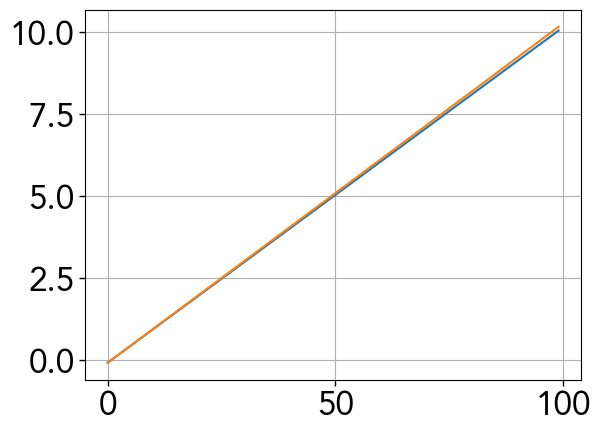

In [34]:
plt.plot(np.arange(0,100,1),np.arange(0,100,1) * 0.10231522614022148 - 0.07802646176998582)
plt.plot(np.arange(0,100,1),np.arange(0,100,1) * 0.10352060887913973 - 0.08235757375284847)
plt.grid()

In [26]:
linregress(np.arange(0.75,4.3,0.5),df_calm.dropna().groupby("Distance").median()["AT"])

LinregressResult(slope=0.007530182127185425, intercept=0.04010583850471357, rvalue=0.7099886753123499, pvalue=0.04848537125257143, stderr=0.003049176255558662, intercept_stderr=0.00838523470278632)

In [27]:
linregress(np.arange(0.75,4.3,0.5),df.drop(columns="Drone").dropna().groupby("Distance").median()["AT"])

LinregressResult(slope=0.03368796577281034, intercept=0.034173355019163715, rvalue=0.8312682112380493, pvalue=0.010541140121633904, stderr=0.009196708531299485, intercept_stderr=0.025290948461073583)

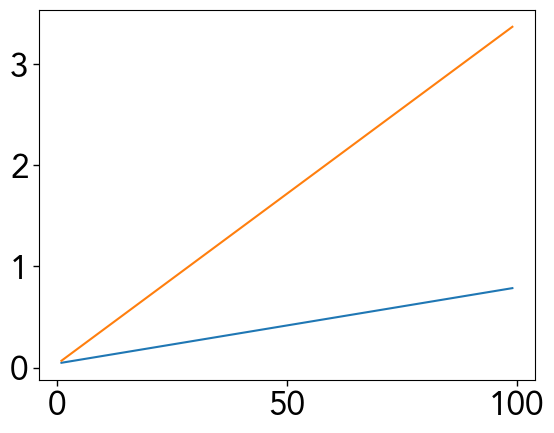

In [28]:
plt.plot(np.arange(1,100,1),np.arange(1,100,1) * 0.007530182127185425 + 0.04010583850471357)
plt.plot(np.arange(1,100,1),np.arange(1,100,1) * 0.03368796577281034 + 0.034173355019163715)
plt.grid()

In [29]:
linregress(np.arange(0.75,4.3,0.5),df_calm.dropna().groupby("Distance").median()["WS"])

LinregressResult(slope=-0.016416384742880936, intercept=0.25000184368717726, rvalue=-0.6927513049736129, pvalue=0.056829410819295094, stderr=0.0069769586051305335, intercept_stderr=0.019186636164108966)

In [30]:
linregress(np.arange(0.75,4.3,0.5),df.drop(columns="Drone").dropna().groupby("Distance").median()["WS"])

LinregressResult(slope=0.10101720893397236, intercept=0.4264790235769279, rvalue=0.9033794478202518, pvalue=0.0020947579189312918, stderr=0.019577037788986902, intercept_stderr=0.05383685391971398)

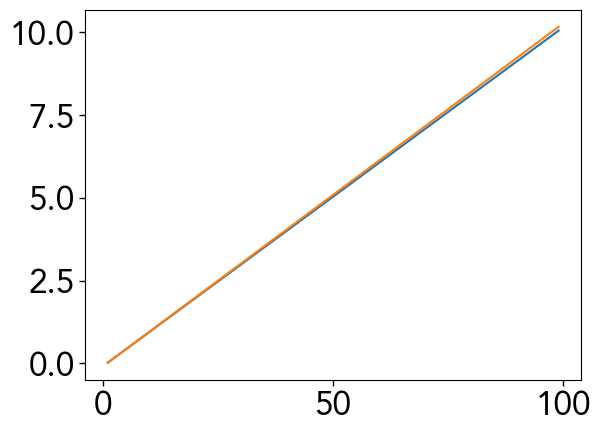

In [25]:
plt.plot(np.arange(1,100,1),np.arange(1,100,1) * 0.10231522614022148 - 0.07802646176998582)
plt.plot(np.arange(1,100,1),np.arange(1,100,1) * 0.10352060887913973 - 0.08235757375284847)

<Axes: xlabel='Distance', ylabel='SST'>

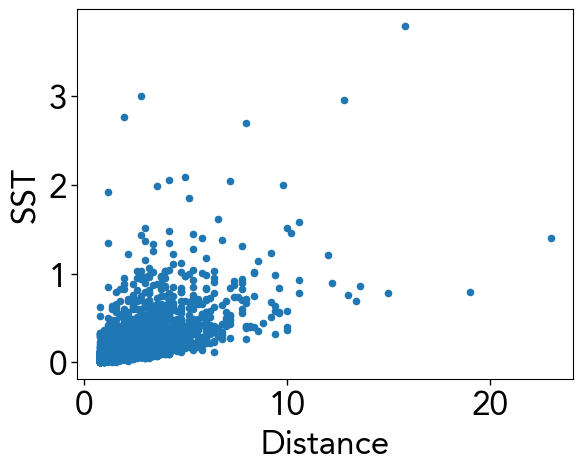

In [11]:
df.plot.scatter(x="Distance", y="SST")

<Axes: xlabel='Distance', ylabel='Qsens'>

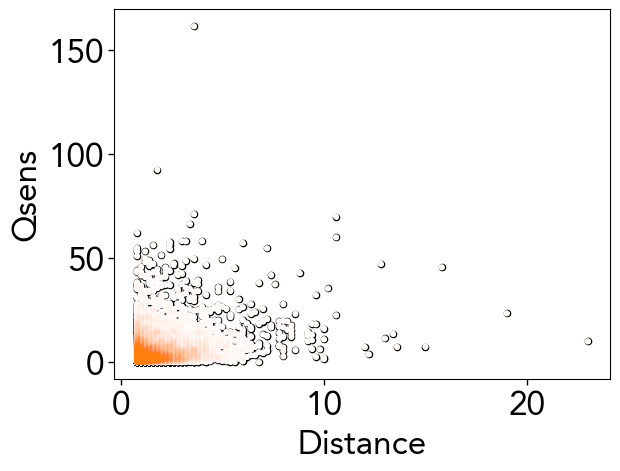

In [23]:
fig,ax = plt.subplots(1,4)
df.plot.scatter(x="Distance", y="Qsens",ec="k",c="w",ax=ax)
df.plot.scatter(x="Distance", y="Qsens",ec="None",c="w",ax=ax)
df.plot.scatter(x="Distance", y="Qsens",ec="None",c="C1",alpha=0.01,ax=ax)

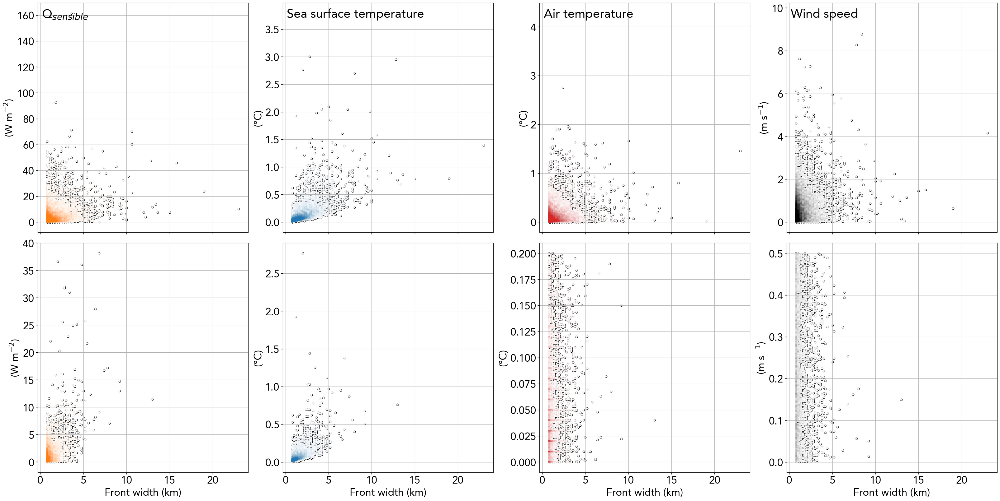

In [29]:
fig, axes = plt.subplots(2,4,figsize=(32,16),constrained_layout=True,sharex=True)

variables = ["Qsens", "SST", "AT", "WS"]
cs = ["C1","C0","C3","k"]
names = [r"Q$_{sensible}$","Sea surface temperature","Air temperature","Wind speed"]
units = ["(W m$^{-2}$)","(°C)","(°C)","(m s$^{-1}$)"]

for ax,v,c,n,u in zip(axes[0],variables,cs,names,units):
    df.plot.scatter(x="Distance", y=v,ec="k",c="w",ax=ax)
    df.plot.scatter(x="Distance", y=v,ec="None",c="w",ax=ax)
    df.plot.scatter(x="Distance", y=v,ec="None",c=c,alpha=0.025,ax=ax)
    ax.set(xlabel="Front width (km)", ylabel=u)
    ax.set_title(n,loc="left",y=0.925,x=0.02)
    ax.grid(zorder=1)

for ax,v,c,n,u in zip(axes[1],variables,cs,names,units):
    df_calm.plot.scatter(x="Distance", y=v,ec="k",c="w",ax=ax)
    df_calm.plot.scatter(x="Distance", y=v,ec="None",c="w",ax=ax)
    df_calm.plot.scatter(x="Distance", y=v,ec="None",c=c,alpha=0.025,ax=ax)
    ax.set(xlabel="Front width (km)", ylabel=u)
    #ax.set_title(n,loc="left",y=0.925,x=0.02)
    ax.grid(zorder=1)

In [16]:
df["Distance"]

0       2.8
1       1.0
2       2.2
3       1.2
4       1.0
       ... 
8433    2.4
8434    1.2
8435    4.8
8436    1.4
8437    0.8
Name: Distance, Length: 8438, dtype: float64

In [15]:
df["Qsens"] * 

0       26.539807
1        4.534163
2             NaN
3             NaN
4        1.860830
          ...    
8433     0.399622
8434     0.569232
8435     3.742289
8436     3.961048
8437     0.742521
Name: Qsens, Length: 8438, dtype: float64

In [17]:
df.drop(columns="Drone").groupby("Distance_Binned").count()["Qsens"]

Distance_Binned
0.75    2383
1.25    2917
1.75     899
2.25     762
2.75     307
3.25     308
3.75     156
4.25     397
Name: Qsens, dtype: int64

In [18]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").count()["Qsens"]

Distance_Binned
0.75    1196
1.25    1640
1.75     576
2.25     515
2.75     221
3.25     216
3.75     109
4.25     321
Name: Qsens, dtype: int64

In [21]:
number = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").count()["Qsens"]
delta  = df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").median()["Qsens"]

<Axes: xlabel='Distance_Binned'>

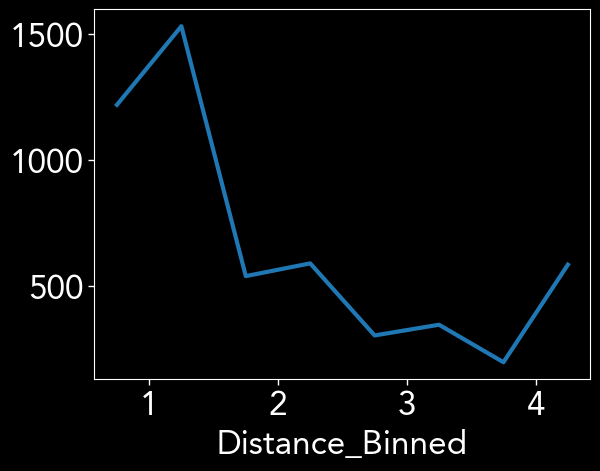

In [27]:
(number * delta).plot()

In [25]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"].sum()

33149.247414670004

In [31]:
#df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["Qsens"].plot()
parts = (df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"]/df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["Qsens"].sum()*100)

In [40]:
edges = np.insert(parts.cumsum(),0,0)

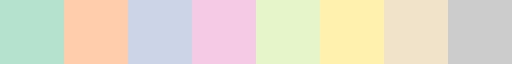

In [49]:
plt.get_cmap("Pastel2")

In [137]:
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens"].count()

Distance_Binned
0.75    1196
1.25    1640
1.75     576
2.25     515
2.75     221
3.25     216
3.75     109
4.25     321
Name: Qsens, dtype: int64

(-0.1, 100.2, -0.49, 1.49)

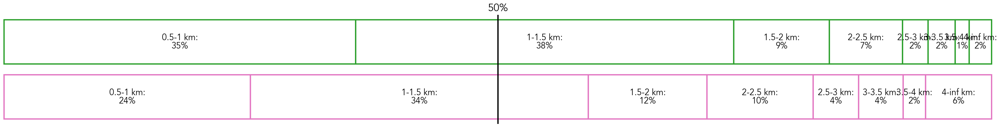

In [138]:
fig, axs = plt.subplots(1,1,figsize=(32,4),constrained_layout=True)

parts = (df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens"].count()/df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned")["Qsens"].count().sum()*100)
edges = np.insert(parts.cumsum(),0,0)

for i in range(len(parts)):
    axs.barh(y=0, left=edges[i], width=parts.iloc[i], color="None", ec="C6",lw=3)
    axs.text(edges[i] + parts.iloc[i]/2, +0.075, f"{bins[i]}-{bins[i+1]} km:", ha="center", va="center", fontsize="small")
    axs.text(edges[i] + parts.iloc[i]/2, -0.075, f"{int(parts.iloc[i])}%", ha="center", va="center", fontsize="small")


axs.text(50,1.5675,"50%",c="k",ha="center")
#axs.text(50,-0.575,"50%",c="w",ha="center")
axs.axvline(50,c="k",ls="-",lw=3)

parts = (df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens"].count()/df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned")["Qsens"].count().sum()*100)
edges = np.insert(parts.cumsum(),0,0)

for i in range(len(parts)):
    axs.barh(y=1, left=edges[i], width=parts.iloc[i], color="None", ec="C2",lw=3)
    axs.text(edges[i] + parts.iloc[i]/2, 1+0.075, f"{bins[i]}-{bins[i+1]} km:", ha="center", va="center", fontsize="small")
    axs.text(edges[i] + parts.iloc[i]/2, 1-0.075, f"{int(parts.iloc[i])}%", ha="center", va="center", fontsize="small")

axs.set(xlim=(-0.1,100.2))

axs.axis("off")

In [59]:
edges[i-2] + parts.iloc[i-2]

84.284549513192

<Axes: xlabel='Distance_Binned'>

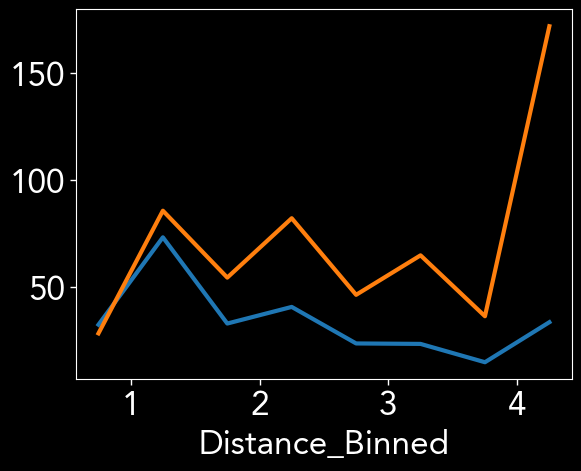

In [30]:
df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["SST"].plot()
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["SST"].plot()

<Axes: xlabel='Distance_Binned'>

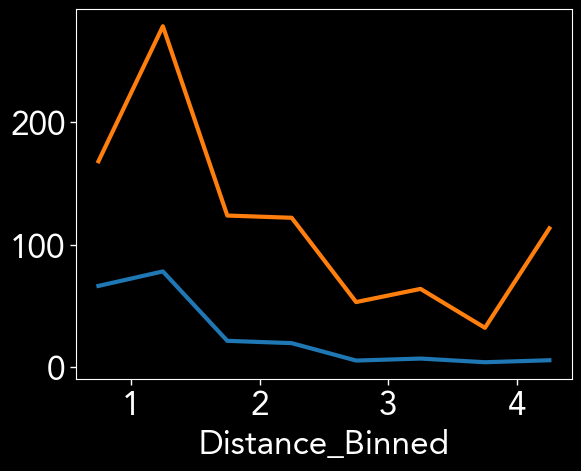

In [31]:
df.drop(columns="Drone").where(df["Calm"]==True).groupby("Distance_Binned").sum()["AT"].plot()
df.drop(columns="Drone").where(df["Calm"]==False).groupby("Distance_Binned").sum()["AT"].plot()

In [43]:
np.where(dists20 < 1)[0]

array([   7,    8,   10,   13,   18,   20,   21,   22,   26,   30,   34,
         36,   38,   46,   47,   49,   51,   55,   57,   59,   63,   64,
         67,   71,   81,   83,   89,   97,   99,  100,  105,  108,  109,
        115,  116,  117,  142,  143,  144,  145,  146,  149,  152,  153,
        157,  172,  173,  177,  179,  182,  191,  192,  193,  197,  198,
        203,  204,  205,  208,  213,  215,  218,  220,  222,  224,  230,
        233,  237,  239,  241,  252,  257,  261,  263,  264,  266,  267,
        270,  274,  278,  279,  280,  282,  285,  287,  296,  307,  312,
        314,  315,  325,  327,  331,  332,  335,  338,  339,  340,  341,
        342,  343,  347,  348,  351,  357,  365,  372,  374,  379,  383,
        384,  394,  398,  401,  410,  412,  413,  418,  427,  430,  433,
        434,  436,  437,  438,  441,  443,  450,  453,  455,  456,  470,
        476,  480,  500,  503,  505,  506,  507,  508,  509,  514,  517,
        525,  527,  529,  531,  537,  554,  555,  5

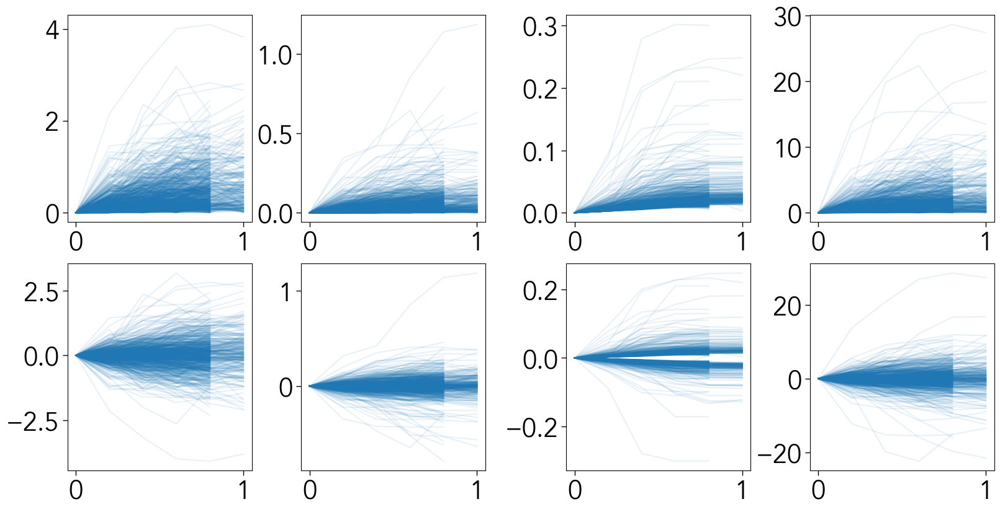

In [56]:
fig, ax = plt.subplots(2,4,figsize=(16,8),constrained_layout=True)

for i in np.where(dists20 <= 1)[0]:
    ss = ds20.isel(distance=slice(start20[i],end20[i]+1))
    
    ax[0][0].plot(ss.distance - ss.distance[0], np.abs(ss["wind_speed"] - ss["wind_speed"][0]),c="C0", alpha=0.1)
    ax[0][1].plot(ss.distance - ss.distance[0], np.abs(ss["at"] - ss["at"][0]),c="C0", alpha=0.1)
    ax[0][2].plot(ss.distance - ss.distance[0], np.abs(ss["sst"] - ss["sst"][0]),c="C0", alpha=0.1)
    ax[0][3].plot(ss.distance - ss.distance[0], np.abs(ss["sensible"] - ss["sensible"][0]),c="C0", alpha=0.1)

    ax[1][0].plot(ss.distance - ss.distance[0], (ss["wind_speed"] - ss["wind_speed"][0]),c="C0", alpha=0.1)
    ax[1][1].plot(ss.distance - ss.distance[0], (ss["at"] - ss["at"][0]),c="C0", alpha=0.1)
    ax[1][2].plot(ss.distance - ss.distance[0], (ss["sst"] - ss["sst"][0]),c="C0", alpha=0.1)
    ax[1][3].plot(ss.distance - ss.distance[0], (ss["sensible"] - ss["sensible"][0]),c="C0", alpha=0.1)


posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

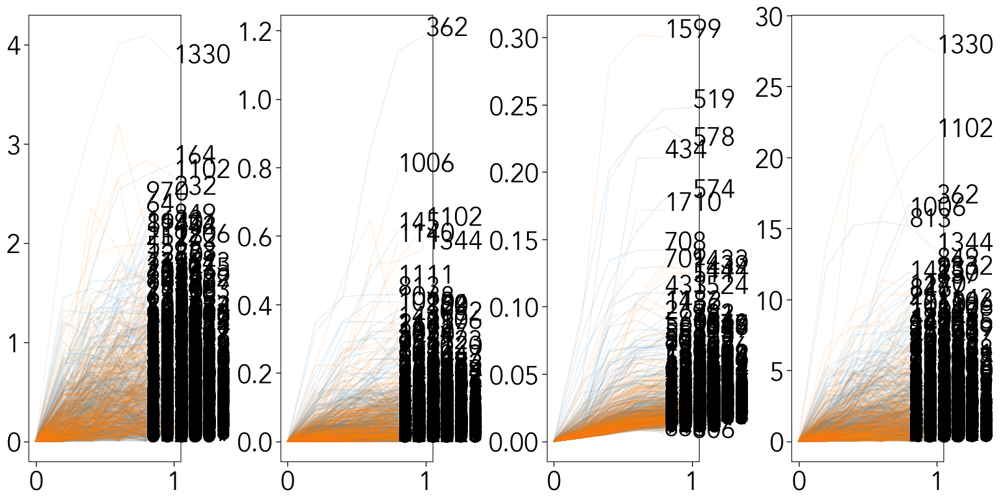

In [63]:
fig, axs = plt.subplots(1,4,figsize=(16,8),constrained_layout=True)

for i in np.where(dists20 <= 1)[0]:
    ss = ds20.isel(distance=slice(start20[i],end20[i]+1))
    c = "C0" if (ss["sst"][0]-ss["sst"][-1]) < 0 else "C1"
    
    for ax,v in zip(axs,["wind_speed","at","sst","sensible"]):    
        ax.plot(ss.distance - ss.distance[0], np.abs(ss[v] - ss[v][0]),c=c, alpha=0.1)
        ax.text((ss.distance - ss.distance[0])[-1],np.abs(ss[v] - ss[v][0])[-1],i)


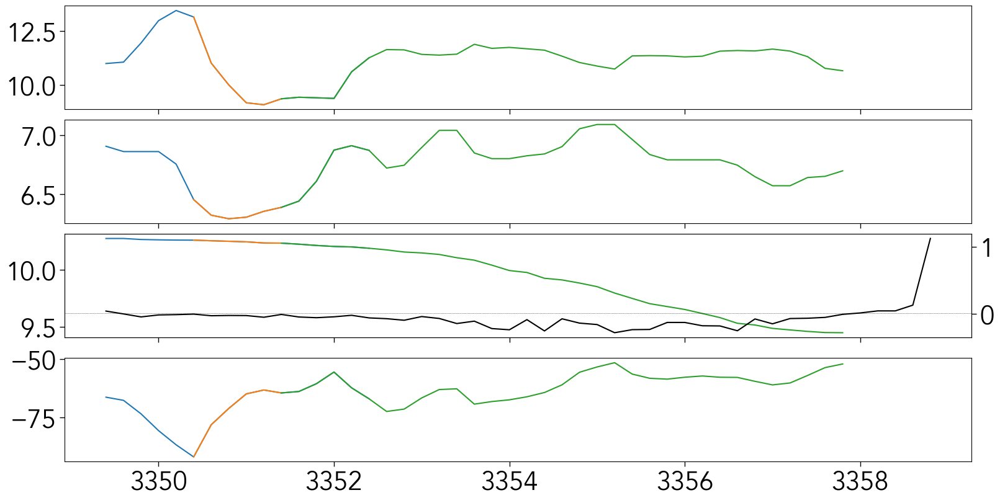

In [76]:
fig, axs = plt.subplots(4,1,figsize=(16,8),constrained_layout=True, sharex=True)

i=1330
ss1 = ds20.isel(distance=slice(start20[i]-5,end20[i]+6))
ss2 = ds20.isel(distance=slice(start20[i],end20[i]+1))
ss3 = ds20.isel(distance=slice(start20[i+1],end20[i+1]+1))

for ax,v in zip(axs,["wind_speed","at","sst","sensible"]):    
    ax.plot(ss1.distance, ss1[v],c="C0")
    ax.plot(ss2.distance, ss2[v],c="C1")
    ax.plot(ss3.distance, ss3[v],c="C2")

bx = axs[2].twinx()

ss1 = ds20.isel(distance=slice(start20[i]-5,end20[i+1]+6))

bx.plot(ss1.distance,ss1["sst_grad"],c="k")
bx.axhline(0.0125,c="k",lw=0.5,ls=":")

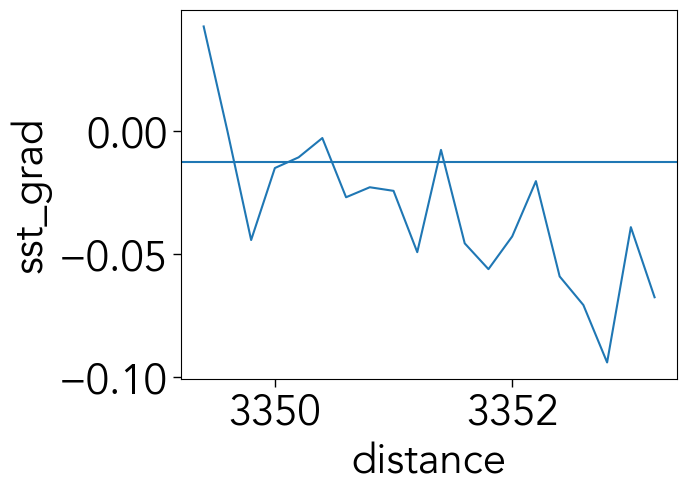

In [90]:
ss1["sst_grad"][:20].plot()
plt.axhline(-0.0125)
